# Clone a Group 

This sample notebook can be used for cloning one or more groups, either on the same portal or from one portal to another.

**Note:** If you want to clone all portal users, groups and content refer to the sample 
[Clone Portal users, groups and content](clone_portal_users_groups_and_content.ipynb)

In this sample, we will clone the [Vector Basemaps](http://www.arcgis.com/home/group.html?id=30de8da907d240a0bccd5ad3ff25ef4a) group from ArcGIS Online to an ArcGIS Enterprise.

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Clone-a-Group" data-toc-modified-id="Clone-a-Group-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Clone a Group</a></span><ul class="toc-item"><li><span><a href="#Define-the-source-and-target-portals" data-toc-modified-id="Define-the-source-and-target-portals-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Define the source and target portals</a></span></li><li><span><a href="#Search-for-the-group-and-its-contents-in-the-source-portal" data-toc-modified-id="Search-for-the-group-and-its-contents-in-the-source-portal-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Search for the group and its contents in the source portal</a></span></li><li><span><a href="#Clone-the-group-in-the-target-portal-if-it-does-not-already-exist." data-toc-modified-id="Clone-the-group-in-the-target-portal-if-it-does-not-already-exist.-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Clone the group in the target portal if it does not already exist.</a></span></li><li><span><a href="#Clone-the-contents-of-the-group-to-the-target-portal" data-toc-modified-id="Clone-the-contents-of-the-group-to-the-target-portal-1.4"><span class="toc-item-num">1.4&nbsp;&nbsp;</span>Clone the contents of the group to the target portal</a></span></li></ul></li></ul></div><li><span><a href="#Clone-the-contents-of-the-group-to-the-target-portal" data-toc-modified-id="Analyzing Organization Content with Pandas-2.0"><span class="toc-item-num">2.0&nbsp;&nbsp;</span>Analyzing Organization Content with Pandas</a></span></li>

In [1]:
from arcgis.gis import GIS
from IPython.display import display
from getpass import getpass
import pdb
import pandas as pd 

## Define the source and target portals

To start with, define the source and target portals.

In [2]:
source_password = getpass()
target_password = getpass()
source = GIS("https://asker.maps.arcgis.com/", "source_user", "source_password")
target = GIS("https://askereu.maps.arcgis.com/","target_user" ,"target_password" )
target_admin_username = 'admin'

········
········


## Search for the group and its contents in the source portal
In the source portal, search for the group to be cloned. In our case the title of the group is 'Vector Basemaps'.

In [3]:
#!esri_ & !admin
source_users = source.users.search('!esri_ & !admin')
for user in source_users:
    print(user.username + "\t:\t" + str(user.role))

Anders.Opstad_Asker	:	org_publisher
Asmund.Stemme_Asker	:	org_admin
Borth.Aadne.Saetrenes_Asker	:	org_publisher
Carla.Kimmels.De.Jong_Asker	:	org_publisher
Christian.Jorgensen_NS	:	org_user
Christine.Onvik.Amundsen_Asker	:	org_user
dragos.paraschiv_Asker	:	org_admin
Eirik.Larsen_Asker	:	org_user
erik.Borsum_Traftec	:	org_user
evgeny.kazantsev_RS	:	org_publisher
Fredrik.Helverschou_Asker	:	org_user
Gjermund.Deggerdal_Asker	:	org_publisher
Gyda.Gustum.Spurkland_Asker	:	org_user
Hanne.Morsund_Asker	:	org_publisher
Heidi.Rustand_Asker	:	org_user
Ingvild.Hjortdahl.Becke_Asker	:	org_user
Integrasjonsbruker_Asker	:	org_admin
Jan.Sommerstad_Asker	:	org_publisher
Johan.Dalsrud_Asker	:	org_user
kjell.tore.parr_Asker	:	org_admin
kristian.hagen_NS	:	org_user
Kristin.Jenssen.Sola_Asker	:	org_publisher
Kristin.Tandberg_Asker	:	org_user
Leah.Katz_Asker	:	org_user
lukasz.jagodzinski_Traftec	:	org_user
marius.gulbrandsen_Asker	:	org_user
Marius.jokerud_NS	:	org_user
Martin.Stensland_Asker	:	org_user
ov

In [219]:
source_groups = source.groups.search(" !Basemaps & !Gatelys")
source_groups[:3]

[<Group title:"202011_Stedsanalyse_Storymap" owner:Asmund.Stemme_Asker>,
 <Group title:"202101_strandsone3D" owner:Rebekka.Fiksdal_Asker>,
 <Group title:"202104_Kommuneplan" owner:Rebekka.Fiksdal_Asker>]

In [190]:
target_users = target.users.search('!esri_ & !admin')
for user in target_users:
    print(user.username + "\t:\t" + str(user.role))

Anders.Opstad@asker.kommune.no_askereu	:	org_publisher
Asmund.Stemme@asker.kommune.no_askereu	:	org_admin
Asmund.Stemme_Asker5	:	org_admin
Borth.Aadne.Saetrenes@asker.kommune.no_askereu	:	org_publisher
Carla.Kimmels.De.Jong@asker.kommune.no_askereu	:	org_publisher
Christian.Jorgensen_NSeu	:	org_user
Christine.Onvik.Amundsen@asker.kommune.no_askereu	:	org_user
Dragos.Paraschiv@asker.kommune.no_askereu	:	org_admin
Eirik.Larsen@asker.kommune.no_askereu	:	org_user
Erik.Borsum_Trafteceu	:	org_user
Evgeny.Kazantsev_RSeu	:	org_publisher
Fredrik.Helverschou@asker.kommune.no_askereu	:	org_user
Gatelys.Gatelys	:	org_publisher
giselle.linares_askereu	:	org_admin
Gjermund.Deggerdal@asker.kommune.no_askereu	:	org_publisher
Gyda.Gustum.Spurkland@asker.kommune.no_askereu	:	org_user
Hanne.Morsund@asker.kommune.no_askereu	:	org_user
Heidi.Rustand@asker.kommune.no_askereu	:	org_user
Ingvild.Hjortdahl.Becke@asker.kommune.no_askereu	:	org_user
Integrasjonsbruker_Askereu	:	org_admin
Jan.Sommerstad@asker.ko

List the items that are a part of the group 'Vector Basemaps'.

In [220]:
target_groups = target.groups.search("!owner:esri_* & !Basemaps")
target_groups[:3]

[<Group title:"202011_Stedsanalyse_Storymap" owner:Asmund.Stemme@asker.kommune.no_askereu>,
 <Group title:"202101_strandsone3D" owner:Rebekka.Fiksdal@asker.kommune.no_askereu>,
 <Group title:"202104_Kommuneplan" owner:Rebekka.Fiksdal@asker.kommune.no_askereu>]

<Group title:"Publikumskart" owner:kjell.tore.parr_Asker>
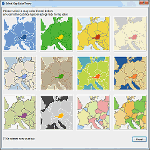

In [194]:
source_testgroup= source.groups.search("Publikumskart")[0]
source_testgroup

In [195]:
source_items = source_testgroup.content()
source_items

[<Item title:"WFS_innbyggerdialog_strippet" type:Feature Layer Collection owner:Asmund.Stemme_Asker>]

In [189]:
len(source_items)

53

## Clone the group in the target portal if it does not already exist. 

We create a new group in the target portal with all the properties of the group in the source portal. 

In [190]:
target_group=target.groups.search('Publikumsinnspill_kommunekart')[0]
target_group

<Group title:"Publikumsinnspill_kommunekart" owner:Asmund.Stemme@asker.kommune.no_askereu>

## Clone the contents of the group to the target portal
It is possible that some items to be cloned may already be present on the target portal. In such a situation, we simply share those items with the target group. Thus, in the section below, we renew our list of items to be cloned by removing from it, any item that was existing on the target portal beforehand.

<Item title:"Annen fritidseiendom matrikkelbyggpunkt" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
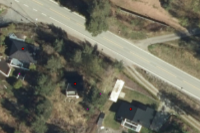

<Item title:"AR5_basert_FKB_vann" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
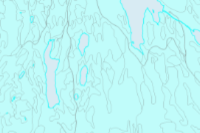

<Item title:"AR5_flate_21_FulldyrkaMark" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
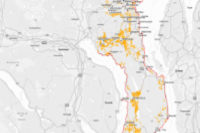

<Item title:"AR5_flate_Vann_elv" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
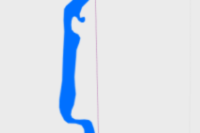

<Item title:"AR5_flate_VEI" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
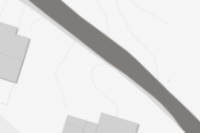

<Item title:"AR5_flate_VEI_tile" type:Map Image Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
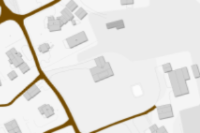

<Item title:"AR5_flate_VEI_vectortile" type:Map Image Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
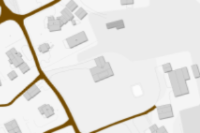

<Item title:"Arbeidskart kommuneplan" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
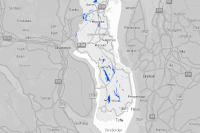

<Item title:"Arealformål_framtidig" type:Feature Layer Collection owner:kjell.tore.parr@asker.kommune.no_askereu>
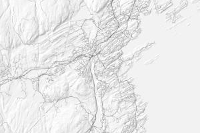

<Item title:"Arealformål_nåværende" type:Feature Layer Collection owner:kjell.tore.parr@asker.kommune.no_askereu>
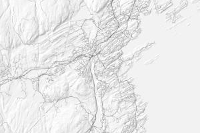

<Item title:"BmNaturtypeOmråde Naturbase" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
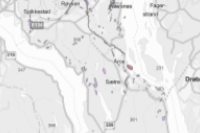

<Item title:"Bolig_og_Senterområder" type:Feature Layer Collection owner:kjell.tore.parr@asker.kommune.no_askereu>
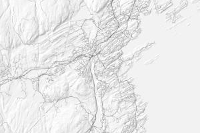

<Item title:"Framtidige_arealformål_Næringsliv" type:Feature Layer Collection owner:kjell.tore.parr@asker.kommune.no_askereu>
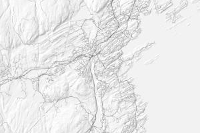

<Item title:"Fritidsbebyggelse matrikkelbyggpunkt" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
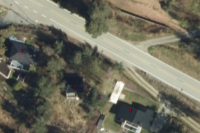

<Item title:"Hytter og annen fritidsbygg" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
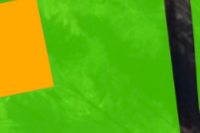

<Item title:"Hytter_i_strandsone100metersbelte" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
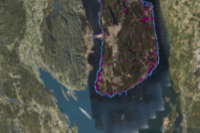

<Item title:"KartlagtFriluftslivsområde_naturbase" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
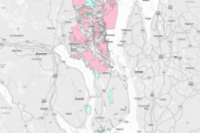

<Item title:"Kollektivaske_medFrekvens" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
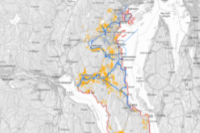

<Item title:"Kollektivaske_medFrekvens_v2" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
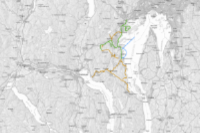

<Item title:"komm" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
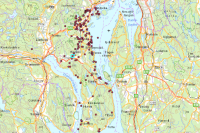

<Item title:"komm2" type:Web Map owner:giselle.linares_askereu>
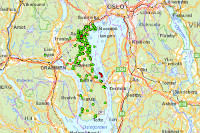

<Item title:"Kommunesenter_punkt" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
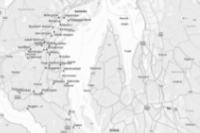

<Item title:"KpArealformålOmråde_CopyFeaturesBebygd" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
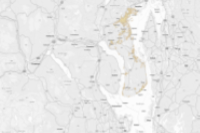

<Item title:"KpArealformålOmråde_CopyFeaturesGroent" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
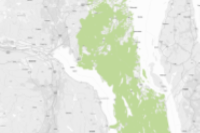

<Item title:"KpArealformålOmråde_LNF" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
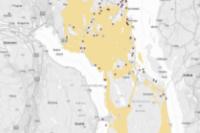

<Item title:"KpArealformålOmråde_LNF_alt_" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
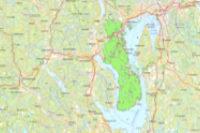

<Item title:"KpJuridiskLinje_line_Strandlinje" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
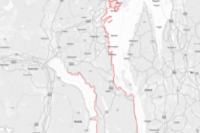

<Item title:"KpJuridiskLinje_line_Strandsone" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
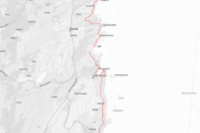

<Item title:"Kulturmiljoer" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
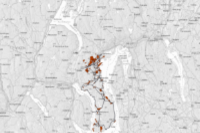

<Item title:"Lokalsenter_punkt" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
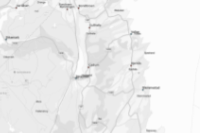

<Item title:"Lokalsenter_punkt_v2" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
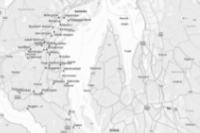

<Item title:"markagrensa_gml_hurum_underarbeid" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
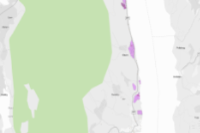

<Item title:"markagrensa_gml_hurum_underarbeid_LINJE" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
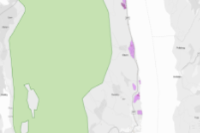

<Item title:"Markagrense" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
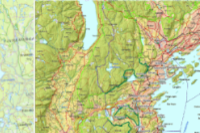

<Item title:"N50_Arealdekke_AskerOmegn_HavOgElv" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
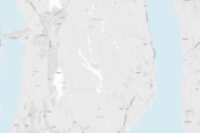

<Item title:"N50_Arealdekke_AskerOmegn_Vann_alt" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
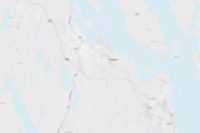

<Item title:"Nærsenter_punkt" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
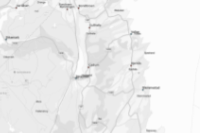

<Item title:"Naturtyper_NiN Naturbase" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
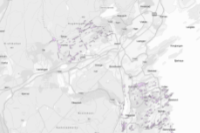

<Item title:"Naturvernområde NATURBASE" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
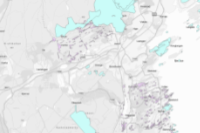

<Item title:"Nåværende_arealformål_Næringsliv" type:Feature Layer Collection owner:kjell.tore.parr@asker.kommune.no_askereu>
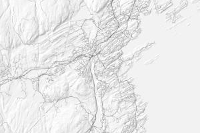

<Item title:"Regulerte hyttetomter BEBYGD" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
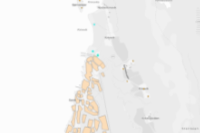

<Item title:"Regulerte hyttetomter UBEBYGD" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
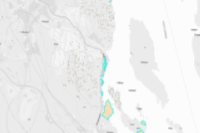

<Item title:"RpArealformål1120_RbFormål_150_flate_FRITIDSBEBYGGELSE" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
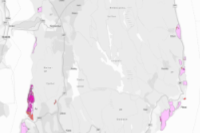

<Item title:"Vann_flate_grunnkart" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
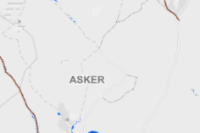

<Item title:"Vann_flate_minus_hav_kilde_grunnkart" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
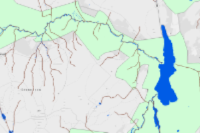

<Item title:"Vegkategori_europa_fylkesvei" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
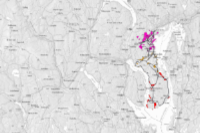

<Item title:"Vekstomraade" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
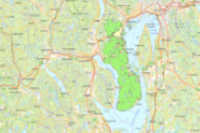

<Item title:"Vekstomraade2" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
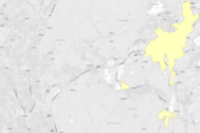

<Item title:"WFS_innbyggerdialog_komplanrevisjon_full_kopi_21102020" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
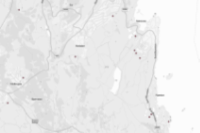

<Item title:"WFS_innbyggerdialog_strippet" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
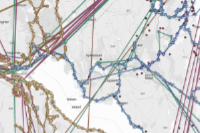

In [191]:
#making a list for the items to be cloned in the target portal
items_to_be_cloned = list(source_items)

#checking for the presence of the item in the target portal 
for item in source_items:
    searched_items = target.content.search(query='title:'+item.title, item_type = item.type)   
    
    for s_item in searched_items:
        
        if s_item.title == item.title:
            
            #if an item is not a part of the group in the target portal then share it 
            if s_item not in target_group.content():
                s_item.share(groups= [target_group])
            
            #remove the already existing item from the list of items to be cloned
            items_to_be_cloned.remove(item)                
            
            #display the item
            display(s_item)      
                     
            break


Now after having removed the existing items from the list of items to be cloned, we can easily copy the remaining content of the source group to the newly created group in the target portal.  

<Item title:"Overvann/Flomkart (Marius)-Copy-Copy" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
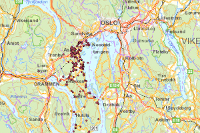

<Item title:"Publikumsinnspill kommuneplan DEMO" type:Web Mapping Application owner:Asmund.Stemme@asker.kommune.no_askereu>
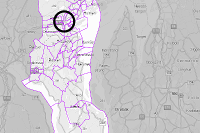

<Item title:"Publikumsinnspill kommuneplan DEMO" type:Code Attachment owner:Asmund.Stemme@asker.kommune.no_askereu>

In [193]:
#cloning all items that were not present on the portal before
import tempfile

for item in items_to_be_cloned:    
    try:
        with tempfile.TemporaryDirectory() as temp_dir:
            thumbnail_file = item.download_thumbnail(temp_dir)
            metadata_file = item.download_metadata(temp_dir)
            target_item_properties = {'title': item.title,
                                      'tags': item.tags,
                                      'text':item.get_data(True),
                                      'type':item.type,
                                      'url':item.url
                                     }       
            #create an item
            target_user = target.users.search(item.owner.split('.')[0])[0]
            target_item = target.content.add(target_item_properties, thumbnail=thumbnail_file, owner=target_user)
            
            #share that item with the group on the target portal
            target_item.share(groups=[target_group])
            
            #display the item
            display(target_item)
            
    except Exception as e:
        print('Item {} could not be created in the target portal'.format(item.title))
        print(e)

In [34]:
import tempfile

GROUP_COPY_PROPERTIES = ['title', 'description', 'tags', 'snippet', 'phone',
                         'access', 'isInvitationOnly']

def copy_group(target, source, source_group):
    
    with tempfile.TemporaryDirectory() as temp_dir:
        try:
            target_group = {}

            for property_name in GROUP_COPY_PROPERTIES:
                target_group[property_name] = source_group[property_name]

            if source_group['access'] == 'org' and target.properties['portalMode'] == 'singletenant':
                #cloning from ArcGIS Online to ArcGIS Enterprise
                target_group['access'] = 'public'

            elif source_group['access'] == 'public'\
                 and source.properties['portalMode'] == 'singletenant'\
                 and target.properties['portalMode'] == 'multitenant'\
                 and 'id' in target.properties:
                    #cloning from ArcGIS Enterprise to ArcGIS Online org
                    target_group['access'] = 'org'

            # Download the thumbnail (if one exists)
            thumbnail_file = None
            if 'thumbnail' in group:
                target_group['thumbnail'] = group.download_thumbnail(temp_dir)

            # Create the group in the target portal
            copied_group = target.groups.create_from_dict(target_group)

            # Reassign all groups to correct owners, add users, and find shared items
            members = group.get_members()
            if not members['owner'] == target_admin_username:
                copied_group.reassign_to(members['owner'])
            if members['users']:
                copied_group.add_users(members['users'])
            return copied_group
        except:
            print("Error creating " + source_group['title'])

### Reassigning ownership to groups in target portal 

In [135]:
for tg in target_groups:
    for sg in source_groups_asmund:
        if sg.title == tg.title and (not tg.owner.startswith('esri_')):
            if tg.get_members()['owner']!= sg.get_members()['owner']:
                tg.reassign_to(members['owner'])
                print("Reassigning ownership to groups {} in target Portal...".format(tg.title))
                continue

Reassigning ownership to groups 202011_Stedsanalyse_Storymap in target Portal...
Reassigning ownership to groups 202104_Koronadashboard in target Portal...
Reassigning ownership to groups 202109_NADAG_grunnundersokelser in target Portal...
Reassigning ownership to groups 3D utviklingsprosjekt in target Portal...
Reassigning ownership to groups Forside in target Portal...
Reassigning ownership to groups Matrikkeltest in target Portal...
Reassigning ownership to groups Publikumsinnspill_kommunekart in target Portal...
Reassigning ownership to groups Testgruppe_migrering_Åsmunds_bruker in target Portal...
Reassigning ownership to groups Tom gruppe in target Portal...
Reassigning ownership to groups Tom gruppe 2 in target Portal...
Reassigning ownership to groups WMS - test in target Portal...


## Analyzing Organization Content with Pandas

In [196]:
org_users = source.users.search()
print(f'{len(org_users)} users found')
org_users[:3]

47 users found


[<User username:Anders.Opstad_Asker>,
 <User username:Asmund.Stemme_Asker>,
 <User username:Borth.Aadne.Saetrenes_Asker>]

In [197]:
tar_users = target.users.search()
print(f'{len(tar_users)} users found')

48 users found


In [198]:
org_content = []

for user in org_users:
    qe = f"owner: {user.username}"
    user_content = source.content.advanced_search(query=qe, max_items=-1)['results']
    org_content += user_content
    
print(f"{len(org_content)} items found in org")

3174 items found in org


In [199]:
tar_content = []

for user in tar_users:
    qe = f"owner: {user.username}"
    user_content = target.content.advanced_search(query=qe, max_items=-1)['results']
    tar_content += user_content
    
print(f"{len(tar_content)} items found in target portal")

2640 items found in target portal


In [210]:
content_df = pd.DataFrame(org_content)
content_df[:3]

,id,owner,created,isOrgItem,modified,guid,name,title,type,typeKeywords,...,groupDesignations,contentOrigin,lastViewed,layers,tables,size,commentsEnabled,itemControl,sourceUrl,contentStatus
0,5dc934936a8c4005a297cdb7a7ca0515,Asmund.Stemme_Asker,1622460706000,True,1668604139000,None,None,"3DbygningerStorhaug_v2, Bygninger",Scene Service,"[3DObject, ArcGIS Server, Data, Scene Service,...",...,None,self,1669384800000,"[<Object3DLayer url:""https://tiles.arcgis.com/...",[],252954.0,True,admin,NaN,NaN
1,f9339711881e4c79960bf40d5c517ea2,Asmund.Stemme_Asker,1622460702000,True,1622460704000,None,Bygninger_Norge_3DbygningerStorhaug_20210531_1...,"3DbygningerStorhaug_v2, Bygninger",Scene Package,"[3D, ArcGIS Pro, ArcGIS Server, Scene, Scene P...",...,None,self,1668600000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,aad32eeaae65462abacd3658ea7b8837,Asmund.Stemme_Asker,1622461172000,True,1622461257000,None,Elevation_mosaikk_3DbygningerStorhaug_20210531...,"3DbygningerStorhaug_v2, Terrengmodell 0.5m, L...",Image Service,"[ArcGIS Server, Data, Elevation 3D Layer, Imag...",...,None,self,1668812400000,None,None,NaN,NaN,NaN,NaN,NaN


In [211]:
tar_content_df = pd.DataFrame(tar_content)
tar_content_df[:3]

,id,owner,created,isOrgItem,modified,guid,name,title,type,typeKeywords,...,scoreCompleteness,groupDesignations,contentOrigin,lastViewed,layers,tables,size,commentsEnabled,itemControl,sourceUrl
0,66357e141e3b4604ab06845fa058c83f,Asmund.Stemme@asker.kommune.no_askereu,1669317559000,True,1669317560000,None,None,"3DbygningerStorhaug_v2, Bygninger",Scene Service,"[3DObject, ArcGIS Server, Data, Scene Service,...",...,55,None,self,-1,"[<Object3DLayer url:""https://tiles.arcgis.com/...",[],132.0,True,admin,NaN
1,1108792f851843de8ed775afd64da604,Asmund.Stemme@asker.kommune.no_askereu,1666789118000,True,1666939185000,None,Bygninger_Norge_3DbygningerStorhaug_20210531_1...,"3DbygningerStorhaug_v2, Bygninger",Scene Package,"[3D, ArcGIS Pro, ArcGIS Server, Metadata, Scen...",...,55,None,self,-1,NaN,NaN,NaN,NaN,NaN,NaN
2,8a480988a55b420fa9a1747a015fe5d7,Asmund.Stemme@asker.kommune.no_askereu,1668600568000,True,1668600569000,None,None,"3DbygningerStorhaug_v2, Terrengmodell 0.5m, L...",Image Service,"[ArcGIS Server, Data, Elevation 3D Layer, Imag...",...,56,None,self,1668600000000,None,None,NaN,NaN,NaN,NaN


In [200]:
content_df.type.value_counts()

Feature Service                 903
Service Definition              724
Scene Service                   220
Web Map                         212
Dashboard                       141
Scene Package                   134
Web Mapping Application         133
Web Scene                       110
Code Attachment                  81
Shapefile                        69
WMS                              66
Map Service                      50
File Geodatabase                 48
CSV                              46
Image Service                    43
Tile Package                     36
Image                            35
StoryMap                         34
Web Experience                   16
WFS                              12
Vector Tile Service              12
PDF                              10
Geoprocessing Sample             10
Layer Package                     6
Form                              4
Feature Collection                3
Geocoding Service                 3
Microsoft Excel             

In [201]:
tar_content_df.type.value_counts()

Feature Service            324
Service Definition         136
Dashboard                  104
Web Map                     78
Scene Service               55
Scene Package               44
Web Scene                   21
Map Service                 18
Image Service               13
Code Attachment             13
File Geodatabase            12
Web Mapping Application     11
Tile Package                10
WMS                          8
Image                        6
StoryMap                     5
WFS                          4
Vector Tile Service          4
Layer Package                3
Geoprocessing Sample         3
Solution                     1
Form                         1
StoryMap Theme               1
Vector Tile Package          1
Name: type, dtype: int64

In [208]:
pd.options.display.max_rows=4000
content_df.groupby('owner').type.value_counts()


owner                        type                        
Asmund.Stemme_Asker          Feature Service                 293
                             Service Definition              275
                             Scene Service                   112
                             Dashboard                       110
                             Web Mapping Application          67
                             Scene Package                    61
                             Web Map                          55
                             Web Scene                        52
                             Code Attachment                  43
                             Map Service                      37
                             WMS                              35
                             Image                            33
                             File Geodatabase                 25
                             Image Service                    24
                             Til

In [209]:
pd.options.display.max_rows=4000
tar_content_df.groupby('owner').type.value_counts()

owner                                           type                        
Asmund.Stemme@asker.kommune.no_askereu          Feature Service                 320
                                                Service Definition              136
                                                Scene Service                   115
                                                Dashboard                       108
                                                Web Map                          68
                                                Scene Package                    44
                                                Web Scene                        24
                                                Image                            23
                                                Map Service                      20
                                                Web Mapping Application          20
                                                Code Attachment                  19

In [212]:
view_columns = ['id','title','owner','type','access']

In [213]:
content_df[view_columns].head()

,id,title,owner,type,access
0,5dc934936a8c4005a297cdb7a7ca0515,"3DbygningerStorhaug_v2, Bygninger",Asmund.Stemme_Asker,Scene Service,public
1,f9339711881e4c79960bf40d5c517ea2,"3DbygningerStorhaug_v2, Bygninger",Asmund.Stemme_Asker,Scene Package,public
2,aad32eeaae65462abacd3658ea7b8837,"3DbygningerStorhaug_v2, Terrengmodell 0.5m, L...",Asmund.Stemme_Asker,Image Service,public
3,5901b58b78ec4579a48402b7635ce566,"3DbygningerStorhaug_v2, Terrengmodell 0.5m, L...",Asmund.Stemme_Asker,Tile Package,public
4,36056c86c866415c9d6fff729c6f2b83,"3DbygningerStorhaug_v2, Web Scene, produsert ...",Asmund.Stemme_Asker,Web Scene,public


In [214]:
tar_content_df[view_columns].head()

,id,title,owner,type,access
0,66357e141e3b4604ab06845fa058c83f,"3DbygningerStorhaug_v2, Bygninger",Asmund.Stemme@asker.kommune.no_askereu,Scene Service,public
1,1108792f851843de8ed775afd64da604,"3DbygningerStorhaug_v2, Bygninger",Asmund.Stemme@asker.kommune.no_askereu,Scene Package,public
2,8a480988a55b420fa9a1747a015fe5d7,"3DbygningerStorhaug_v2, Terrengmodell 0.5m, L...",Asmund.Stemme@asker.kommune.no_askereu,Image Service,public
3,d0bf881a0302493a8f849f83df693e20,"3DbygningerStorhaug_v2, Terrengmodell 0.5m, L...",Asmund.Stemme@asker.kommune.no_askereu,Tile Package,public
4,7dd03889a5064190a52376a93b81476e,"3DbygningerStorhaug_v2, Web Scene, produsert ...",Asmund.Stemme@asker.kommune.no_askereu,Web Scene,public


### Selecting content from dataframes by type

In [67]:
filter_value = 'Service Definition'
filter_column = 'type'
row_filter = content_df[filter_column]==filter_value
content_df[row_filter][view_columns]

,id,title,owner,type,access
102,2eda132aeecb4768b073d28a59487557,Polygoner,Asmund.Stemme_Asker,Service Definition,shared
103,906c3e12569f4cfbb63bbea4e5bb0ccd,Polygonlag_test_storymap,Asmund.Stemme_Asker,Service Definition,private
109,22682f6c1c244e0abbb05329ac94414f,Punkter 4 juli,Asmund.Stemme_Asker,Service Definition,private
111,f10a8b6d52624fbb84d7a4a86a96b7c6,Punkter_14iuni_TEST_UTM33,Asmund.Stemme_Asker,Service Definition,private
119,539889ddcbda4f2bb5e720aa46010101,RegineEnhet_Vi,Asmund.Stemme_Asker,Service Definition,private
...,...,...,...,...,...
3186,33c1ef523e8e4059aedcf19ef361a3ac,Omriss_plan,Rebekka.Fiksdal_Asker,Service Definition,private
3189,af94ef57ba564528a2a2bd3cc367b17d,Oppbygning,Rebekka.Fiksdal_Asker,Service Definition,private
3191,dca1ed7353ba43f68dea892b6d62694b,Ordinaere_tilPaaskekart2021,Rebekka.Fiksdal_Asker,Service Definition,private
3193,62981e460c2144599bec2f6df26ed461,OrdinaereAnlegg_22mars21,Rebekka.Fiksdal_Asker,Service Definition,private


### Selecting content from dataframes by type and owner

In [215]:
# Combining masks

owner_filter = tar_content_df.owner=='Asmund.Stemme@asker.kommune.no_askereu'
combined_mask = owner_filter & tar_content_df['type'] 

tar_df_content_asmund=tar_content_df[combined_mask]
tar_df_content_asmund[:3]

,id,owner,created,isOrgItem,modified,guid,name,title,type,typeKeywords,...,scoreCompleteness,groupDesignations,contentOrigin,lastViewed,layers,tables,size,commentsEnabled,itemControl,sourceUrl
0,66357e141e3b4604ab06845fa058c83f,Asmund.Stemme@asker.kommune.no_askereu,1669317559000,True,1669317560000,None,None,"3DbygningerStorhaug_v2, Bygninger",Scene Service,"[3DObject, ArcGIS Server, Data, Scene Service,...",...,55,None,self,-1,"[<Object3DLayer url:""https://tiles.arcgis.com/...",[],132.0,True,admin,NaN
1,1108792f851843de8ed775afd64da604,Asmund.Stemme@asker.kommune.no_askereu,1666789118000,True,1666939185000,None,Bygninger_Norge_3DbygningerStorhaug_20210531_1...,"3DbygningerStorhaug_v2, Bygninger",Scene Package,"[3D, ArcGIS Pro, ArcGIS Server, Metadata, Scen...",...,55,None,self,-1,NaN,NaN,NaN,NaN,NaN,NaN
2,8a480988a55b420fa9a1747a015fe5d7,Asmund.Stemme@asker.kommune.no_askereu,1668600568000,True,1668600569000,None,None,"3DbygningerStorhaug_v2, Terrengmodell 0.5m, L...",Image Service,"[ArcGIS Server, Data, Elevation 3D Layer, Imag...",...,56,None,self,1668600000000,None,None,NaN,NaN,NaN,NaN


In [164]:
# Combining masks Web Maps
wm_filter = content_df.type=='Web Map'
owner_filter = content_df.owner=='Asmund.Stemme_Asker'
combined_mask = wm_filter & owner_filter

df1=content_df[combined_mask][view_columns]
len(df1)

81

In [15]:
# Combining masks Web experience
wm_filter = content_df.type=='Web Experience'
owner_filter = content_df.owner=='Asmund.Stemme_Asker'
combined_mask = wm_filter & owner_filter

df1=content_df[combined_mask][view_columns]
df1

,id,title,owner,type,access
294,642db244702844288032c81e97c11615,COVID-19 TEMPLATE 1,Asmund.Stemme_Asker,Web Experience,org
295,9af22454b6394c97872863ed0c1c26bc,COVID-19 TEMPLATE 2,Asmund.Stemme_Asker,Web Experience,private
350,3839e4aa3ffb45428fd28521d46dd338,Test_mobilversjon,Asmund.Stemme_Asker,Web Experience,private
498,0cbc282d89794ccdbad8385d291eb9d1,Koronadashboard_mobilversjon,Asmund.Stemme_Asker,Web Experience,public
1032,974706c9bfb14f4dae1f0f4bb8fa7e08,Koronatall for Asker kommune,Asmund.Stemme_Asker,Web Experience,public
1310,83ecc9ae40ef404cbc1f7a3e8bd2ac32,Valgtalltall for Asker kommune 1,Asmund.Stemme_Asker,Web Experience,public


In [137]:
# Combining masks dashboards
fs_filter = tar_content_df.type=='Feature Service'
owner_filter = tar_content_df.owner=='Asmund.Stemme@asker.kommune.no_askereu'
combined_mask = fs_filter & owner_filter

df2=tar_content_df[combined_mask][view_columns]
len(df2)

276

In [173]:
# Combining masks dashboards
dashboard_filter = tar_content_df.type=='Dashboard'
owner_filter = tar_content_df.owner=='Asmund.Stemme@asker.kommune.no_askereu'
combined_mask = dashboard_filter & owner_filter

df2=tar_content_df[combined_mask][view_columns]
len(df2)

15

### Cleaning dataframes in case of duplicates

In [218]:
df_duplicates=tar_content_df[tar_content_df[['title', 'type']].duplicated() == True]
df_duplicates[:3]

,id,owner,created,isOrgItem,modified,guid,name,title,type,typeKeywords,...,scoreCompleteness,groupDesignations,contentOrigin,lastViewed,layers,tables,size,commentsEnabled,itemControl,sourceUrl
479,566dd06fc0714e529168cacf1039043f,Asmund.Stemme@asker.kommune.no_askereu,1669031954000,True,1669031955000,None,None,Corona dashboard test Om data/Metadata,Dashboard,"[ArcGIS Dashboards, Dashboard, Operations Dash...",...,50,None,self,-1,NaN,NaN,NaN,NaN,NaN,NaN
829,03ebc39bfa91453aaca97f14d28de9e3,Asmund.Stemme@asker.kommune.no_askereu,1669032182000,True,1669032183000,None,None,Koronadashboard Smittede Alder/,Dashboard,"[ArcGIS Dashboards, Dashboard, Operations Dash...",...,55,None,self,-1,NaN,NaN,NaN,NaN,NaN,NaN
936,9a1e682d3b41448189276ee22c4ff649,Asmund.Stemme@asker.kommune.no_askereu,1667482330000,True,1667482331000,None,None,Bygninger_symbolisert_felt_strandsone,Scene Service,"[ArcGIS Server, Data, Scene Service, Service]",...,41,None,self,-1,None,None,NaN,NaN,NaN,NaN


In [72]:
duplicates_index= df_duplicates.index
for i in duplicates_index:
    sd_data = tar_content_df.loc[i].id
    print(sd_data)
    sd_content = target.content.get(sd_data)
    sd_content.delete()

c9633b958cbf4f07825b982670815ed7
a0d9c683a5e0443f9dbee9d6f9c008a5
a4ad19637d6c4fe6b3d1587ec3edce66
e5751416e29f4395b205d70395f882b9
2fed25342d8b46cfb807d6daa487b984
2a4452b153e54c70aea8fa9abb110b22
c63b5f0b79c942d5bdae1d61222ffac1
d4e2e39e210d40c2ad9523f4e42f60da
6d645a19569246b98e0ce0e1f9e34fd4
6c220e8b38f749a2b8497b5ea55406f8
b7fcee0ceda24431b167f3f679376528
423d03eb486b41acb31f9fe39a60fbae
755a335797334a1a863a4127987c514c
4a6852f1b3b84edf9f29a1010f6d6d9e
8cda32b35b9a49e19206d68d20c2996a
71ecf2983b7442a7871936519ce42d6b
0ee016b95e0143f0b1cd9efc95faf165
7548082540dc4170814cbfefa8ec59ab
8340db6565cd4f3696cc3e205c8b92de
513485574c944851b0a45b543d92c913
bf21e85fdee24b67b0ea2d8b2b5d91f8
80fc12152d9f4e4b96504c37938f9461
5d8a074a53564623b047bc705da02a58
eca0308ca3f04f31a33f54dc2d469fe0
8432504534034c2d923c77f5204d865a
b6c512c01d2142278c5d35b283a0936e
41a97adbab4d441294aaea7438809710
be96da2a3991477197bceb867b2ec9ab
b8b41f362ed54d62a0e1c7db0413f0a4
913acd4d5a6d4c4ca3ad7737a663b130
69dcdcdf9f

Exception: Unable to delete item. This service item has a related Service item
(Error Code: 400)

### Comparing source and target dataframes by title in case item is already present in the target dataframe

In [167]:
#Diff wm
list_wm_source=df1['title'].to_list()
list_wm_target=df2['title'].to_list()

diff_wm2=list(set(list_wm_source) - set(list_wm_target))
diff_wm2

['Overvann/Flomkart (Marius)-Copy-Copy',
 'Bilder (UTM32)',
 'Map_migrasjonstest_ÅSbruker',
 'Næringsområder_presentasjon_arbeidskart',
 'Næring_arbeidskart',
 'Coronadashboard_webmap_mobilversjon',
 'Overvann/Flomkart (Marius)-Copy',
 'Næringsområder',
 'Overvann/Flomkart (Marius)-Copy-Copy-Copy_KopiÅsmund',
 'Sentinel_klassifisering_LivingAtlas',
 'Næring_arbeidskart KOPI1',
 'Næring_arbeidskart_pendling',
 'Arbeidskart kommuneplan-Copy_10_12_2020',
 'Daily Activity Dashboard',
 'Overvann/Flomkart (Marius)-Copy-Copy-Copy',
 'Kommuneplan 2020 - Arealdelen-Copy_23_11_2020',
 'Collector_kplan_test_v2',
 'Næringspunkter']

In [138]:
#Diff fs
list_fs_source=df1['title'].to_list()
list_fs_target=df2['title'].to_list()

diff_fs=list(set(list_fs_source) - set(list_fs_target))
diff_fs

['Bratthet2',
 'Demografi_ansatte',
 'NARING_ForetakPunkt_Asker_Ansatte_IkkeENK',
 'Utløpsområde',
 'Vegdatabank (feature)',
 'AR5_flate_2021',
 'Footprints_ASKER_Naering_vectortile_ÅS',
 'meter400_rundt10til30minFrekvensBusstopp_DISSOLVED_copy',
 'NARING_ForetakPunkt_Asker_ALLE',
 'BygningerMedTekstur_Bare_gamle_Trekanten',
 'N50_Arealdekke_AskerOmegn_HavOgElv',
 'GeomapMatrikkelEierWFS',
 'Snøskred Utløsningsområde',
 'Risenga_multipatchv3_utm32',
 'AADT_Asker_CopyFeatures_CopyFeatures2',
 'Bratthet_v4',
 'Kirkeveien_multV3_utm32TOutm33']

### Cloning the items by type and owner

Int64Index([973], dtype='int64')
	Error copying  Overvann/Flomkart (Marius)-Copy-Copy
	('Failed to create Feature Service Catchment_50000: Your request has timed out.\n(Error Code: 504)', <Item title:"Catchment_50000" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>)
	Removing Web Map Overvann/Flomkart (Marius)-Copy-Copy


<Item title:"AADT_Asker_CopyFeatures_CopyFeatures2" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
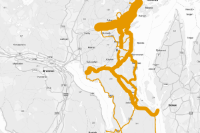

Int64Index([1289], dtype='int64')


<Item title:"Gråtone Terreng vektor (UTM32)" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
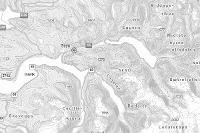

Int64Index([793], dtype='int64')
	Error copying  Næringsområder_presentasjon_arbeidskart
	('Failed to create Feature Service NARING_ForetakPunkt_Asker_Ansatte_IkkeENK: \nField firemail has invalid html content.\n(Error Code: 400)', <Item title:"NARING_ForetakPunkt_Asker_Ansatte_IkkeENK" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>)
	Removing Web Map Næringsområder_presentasjon_arbeidskart


<Item title:"Gråtone Terreng vektor (UTM32)" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
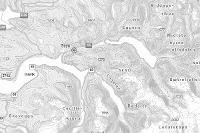

Int64Index([1063], dtype='int64')


<Item title:"Fløtten_Matrikkeltest wfs-kopi" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
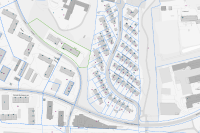

Int64Index([792], dtype='int64')


<Item title:"500 meter gange rundt busstop med 0 til 10 min frekvens" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
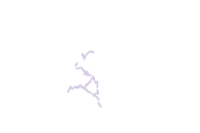

<Item title:"400 meter gange rundt busstop med 10 til 30 min frekvens" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
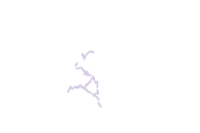

<Item title:"Bussholdeplasser_GTFS_ryddetRebekka" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
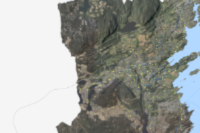

<Item title:"Togstopp" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
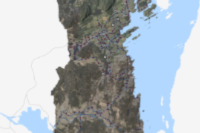

<Item title:"Kommunale_eiendommer" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
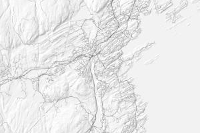

<Item title:"Kommuneavgrensning" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
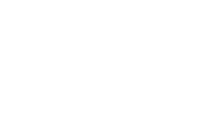

<Item title:"Næringsområder_Green Mountain" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
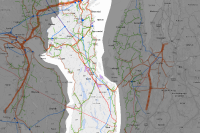

Int64Index([1314], dtype='int64')


<Item title:"Heggedal_2010_2020" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
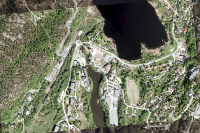

Int64Index([579], dtype='int64')


<Item title:"Ukesrapport_Kart" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
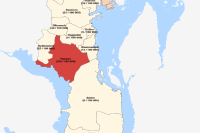

Int64Index([1300], dtype='int64')


<Item title:"Lokalomraade" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
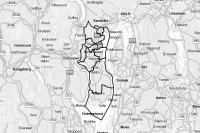

<Item title:"Grunnkrets" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
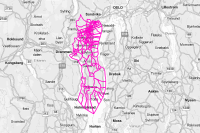

<Item title:"Grunnkrets og lokalområder" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
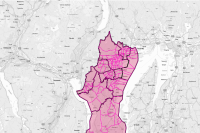

Int64Index([974], dtype='int64')
	Error copying  Overvann/Flomkart (Marius)-Copy-Copy-Copy
	('Failed to create Feature Service Asker_midt_Q20_shp: The page was not displayed because the request entity is too large.', <Item title:"Asker_midt_Q20_shp" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>)
	Removing Web Map Overvann/Flomkart (Marius)-Copy-Copy-Copy


<Item title:"Lokalomraade" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
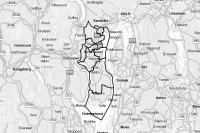

<Item title:"Grunnkrets" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
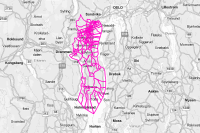

<Item title:"Grunnkrets og lokalområder" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
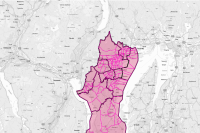

Int64Index([1095], dtype='int64')


<Item title:"FutureBuilt-kopi" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
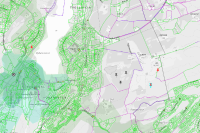

Int64Index([718], dtype='int64')
Int64Index([371], dtype='int64')


<Item title:"kpi_Norge-kopi" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
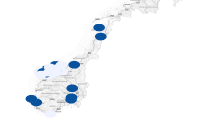

Int64Index([905], dtype='int64')


<Item title:"naturtyper" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
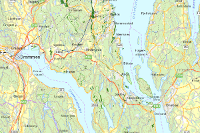

Int64Index([173], dtype='int64')


<Item title:"Skispor TEST 2D webmap" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
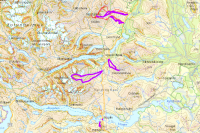

Int64Index([766], dtype='int64')
	Error copying  Næring_arbeidskart
	('Failed to create Feature Service NARING_ForetakPunkt_Asker_ALLE: \nField firemail has invalid html content.\n(Error Code: 400)', <Item title:"NARING_ForetakPunkt_Asker_ALLE" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>)
	Removing Web Map Næring_arbeidskart


<Item title:"Skispor TEST 2D webmap" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
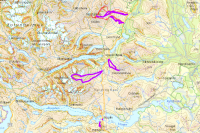

Int64Index([736], dtype='int64')


<Item title:"Matrikkeltest2" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
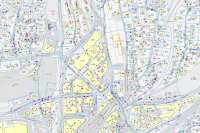

Int64Index([1262], dtype='int64')


<Item title:"WFS_WMS_test_Bergen" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
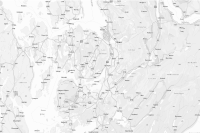

Int64Index([645], dtype='int64')


<Item title:"Kanvas vektor (UTM33)" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
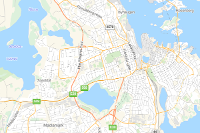

Int64Index([767], dtype='int64')
	Error copying  Næring_arbeidskart KOPI1
	('Failed to create Feature Service Næring_foretakspunkt_ikkeENKOver0ansatte: \nField firemail has invalid html content.\n(Error Code: 400)', <Item title:"Næring_foretakspunkt_ikkeENKOver0ansatte" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>)
	Removing Web Map Næring_arbeidskart KOPI1


<Item title:"Kanvas vektor (UTM33)" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
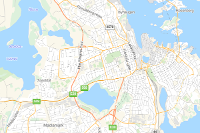

Int64Index([1228], dtype='int64')


<Item title:"Lokalsenter_og_kommunesenter" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
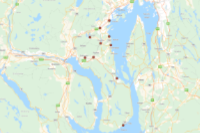

<Item title:"Valgkretser_kladd" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
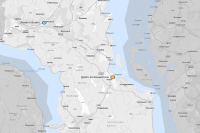

Int64Index([1316], dtype='int64')


<Item title:"Heggedal_2010_2020-Copy-Copy" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
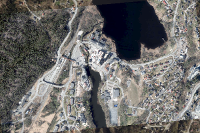

Int64Index([1092], dtype='int64')


<Item title:"FutureBuilt" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
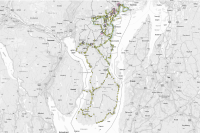

Int64Index([1329], dtype='int64')


<Item title:"Hybrid (UTM33)" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
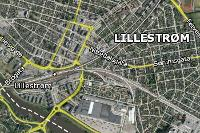

Int64Index([106], dtype='int64')


<Item title:"Jernbane" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
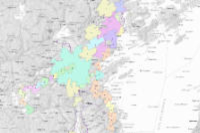

<Item title:"Naersenter_punkt" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
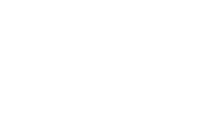

<Item title:"Nærsenter" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
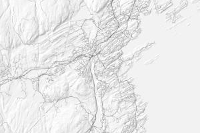

<Item title:"Lokalsenter" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
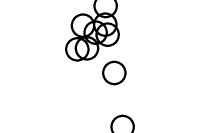

<Item title:"Kommunesenter" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
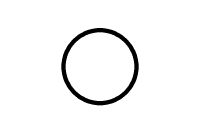

<Item title:"Publikumsinnspill -Copy" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
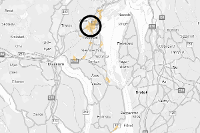

Int64Index([735], dtype='int64')


<Item title:"Matrikkeltest wfs" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
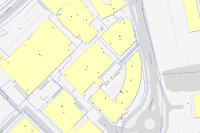

Int64Index([287], dtype='int64')


<Item title:"TEST regplan fra feature" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
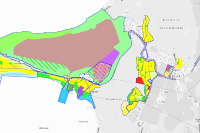

Int64Index([1290], dtype='int64')


<Item title:"Gråtone Terreng vektor (UTM33)" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
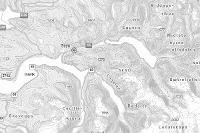

Int64Index([676], dtype='int64')


<Item title:"Arealtype_AR5" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
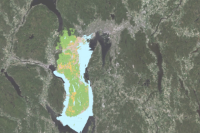

<Item title:"Endringer_arealformål_160322" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
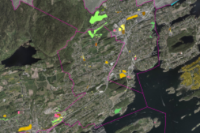

<Item title:"Kommuneplan 2020 - endringer-Kopi_arealregnskap" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
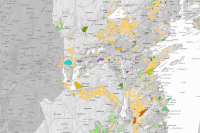

Int64Index([387], dtype='int64')


<Item title:"Landskap (WGS84/UTM33)" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
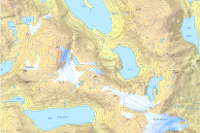

Int64Index([644], dtype='int64')


<Item title:"Kanvas vektor (UTM32)" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
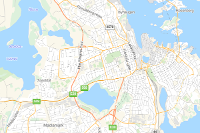

Int64Index([642], dtype='int64')


<Item title:"Kanvas Mørk vektor (UTM32)" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
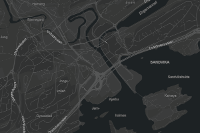

Int64Index([794], dtype='int64')
	Error copying  Næringspunkter
	('Failed to create Feature Service NARING_ForetakPunkt_Asker_ALLE: An error occurred.\n(Error Code: 502)', <Item title:"NARING_ForetakPunkt_Asker_ALLE" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>)
	Removing Web Map Næringspunkter


<Item title:"Kanvas Mørk vektor (UTM32)" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
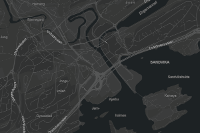

Int64Index([1264], dtype='int64')


<Item title:"WMS_ASkerkart_test_10012022" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
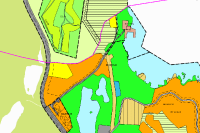

Int64Index([1278], dtype='int64')


<Item title:"Geonorgeskart - bakgrunn-Kopier" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
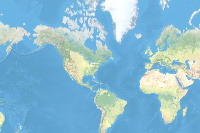

Int64Index([386], dtype='int64')


<Item title:"Landskap (UTM33)" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
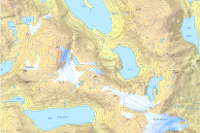

Int64Index([113], dtype='int64')


<Item title:"Polygoner_16juni" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
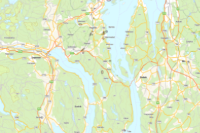

<Item title:"Punkter_14iuni_Merge" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
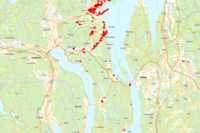

<Item title:"Punkter_og_Polygoner_16juni_kopi" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
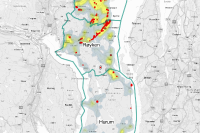

Int64Index([734], dtype='int64')


<Item title:"Matrikkeltest" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
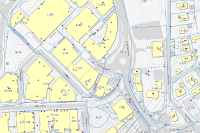

Int64Index([372], dtype='int64')


<Item title:"kpi_Norge_asker" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
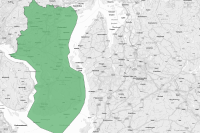

Int64Index([972], dtype='int64')
	Error copying  Overvann/Flomkart (Marius)-Copy
	('Failed to create Feature Service Catchment_25000_shp: Your request has timed out.\n(Error Code: 504)', <Item title:"Catchment_25000_shp" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>)
	Removing Web Map Overvann/Flomkart (Marius)-Copy


<Item title:"kpi_Norge_asker" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
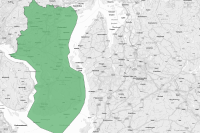

Int64Index([975], dtype='int64')
	Error copying  Overvann/Flomkart (Marius)-Copy-Copy-Copy_KopiÅsmund
	('Failed to create Feature Service Asker_midt_Q200: The page was not displayed because the request entity is too large.', <Item title:"Asker_midt_Q200" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>)
	Removing Web Map Overvann/Flomkart (Marius)-Copy-Copy-Copy_KopiÅsmund


<Item title:"kpi_Norge_asker" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
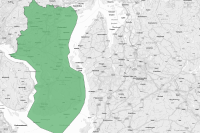

Int64Index([1315], dtype='int64')


<Item title:"Heggedal_2010_2020-Copy" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
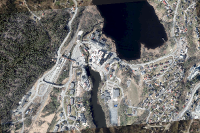

Int64Index([768], dtype='int64')
	Error copying  Næring_arbeidskart_pendling
	('Failed to create Feature Service NARING_ForetakPunkt_Asker_Ansatte_IkkeENK: \nField firemail has invalid html content.\n(Error Code: 400)', <Item title:"NARING_ForetakPunkt_Asker_Ansatte_IkkeENK" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>)
	Removing Web Map Næring_arbeidskart_pendling


<Item title:"Heggedal_2010_2020-Copy" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
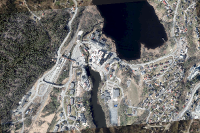

Int64Index([737], dtype='int64')


<Item title:"Matrikkeltest_dragos" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
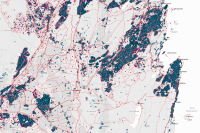

Int64Index([1007], dtype='int64')


<Item title:"Crime Dashboard" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
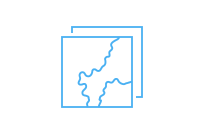

IndexError: list index out of range

In [160]:
#Clon web maps for Stemme

for i in range(len(diff_wm2)):
    diff=df1[df1['title']==diff_wm2[i]]
    target_index= diff.index
    print(target_index)
    for i in target_index:

        source_data = content_df.loc[i].id
        #print(target_data)
        source_content = source.content.get(source_data)

        #find item's owner
        source_item_owner = source.users.search(source_content.owner)[0]
        #find item's folder
        item_folder_titles = [f['title'] for f in source_item_owner.folders 
                              if f['id'] == source_content.ownerFolder]
        folder_name = None
        if len(item_folder_titles) > 0:
            folder_name = item_folder_titles[0]

        #if folder does not exist for target user, create it
        if folder_name:
            target_user = target.users.search('Stemme')[0]
          #  target_user = target.users.search(source_content.owner)[0]
            target_user_folders = [f['title'] for f in target_user.folders
                                   if f['title'] == folder_name]
            if len(target_user_folders) == 0:
                #create the folder
                target.content.create_folder(folder_name, target_user.username)
        try:
            cloned_items = target.content.clone_items([source_content], copy_data=True, search_existing_items=True, owner=target_user, folder=folder_name)
        except Exception as ex:
            print("\tError copying ", str(source_content.title))
            print("\t" + str(ex))
            print("\tRemoving Web Map", str(source_content.title))
            diff_wm2.remove(source_content.title)
            pass
        for ci in cloned_items:
            display(ci)
        if source_content.access == "org":
            ci.share(everyone=False, org=True)
        else:
            ci.share(everyone=True, org=False)

Int64Index([1190], dtype='int64')
	Error copying  Bratthet2
	<!DOCTYPE html PUBLIC "-//W3C//DTD XHTML 1.0 Strict//EN" "http://www.w3.org/TR/xhtml1/DTD/xhtml1-strict.dtd">
<html xmlns="http://www.w3.org/1999/xhtml">
<head>
<meta http-equiv="Content-Type" content="text/html; charset=iso-8859-1"/>
<title>404 - File or directory not found.</title>
<style type="text/css">
<!--
body{margin:0;font-size:.7em;font-family:Verdana, Arial, Helvetica, sans-serif;background:#EEEEEE;}
fieldset{padding:0 15px 10px 15px;} 
h1{font-size:2.4em;margin:0;color:#FFF;}
h2{font-size:1.7em;margin:0;color:#CC0000;} 
h3{font-size:1.2em;margin:10px 0 0 0;color:#000000;} 
#header{width:96%;margin:0 0 0 0;padding:6px 2% 6px 2%;font-family:"trebuchet MS", Verdana, sans-serif;color:#FFF;
background-color:#555555;}
#content{margin:0 0 0 2%;position:relative;}
.content-container{background:#FFF;width:96%;margin-top:8px;padding:10px;position:relative;}
-->
</style>
</head>
<body>
<div id="header"><h1>Server Error</h1></

<Item title:"Pendlerlinjer_delomr_over20_v2" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
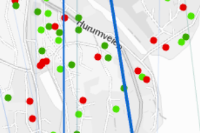

Int64Index([903], dtype='int64')
	Error copying  NARING_ForetakPunkt_Asker_Ansatte_IkkeENK
	('Failed to create Feature Service NARING_ForetakPunkt_Asker_Ansatte_IkkeENK: \nField firemail has invalid html content.\n(Error Code: 400)', <Item title:"NARING_ForetakPunkt_Asker_Ansatte_IkkeENK" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>)
	Removing Feature Service NARING_ForetakPunkt_Asker_Ansatte_IkkeENK


<Item title:"Pendlerlinjer_delomr_over20_v2" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
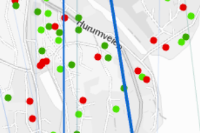

Int64Index([1239], dtype='int64')
	Error copying  Vegdatabank (feature)
	('Failed to create Feature Service Vegdatabank (feature): Error performing query operation\n(Error Code: 500)', <Item title:"Vegdatabank (feature)" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>)
	Removing Feature Service Vegdatabank (feature)


<Item title:"Pendlerlinjer_delomr_over20_v2" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
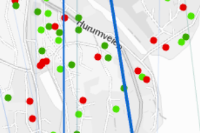

Int64Index([1085], dtype='int64')


<Item title:"Footprints_ASKER_Naering_vectortile_ÅS" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
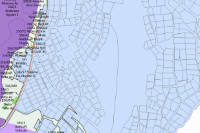

Int64Index([739], dtype='int64')


<Item title:"meter400_rundt10til30minFrekvensBusstopp_DISSOLVED_copy" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
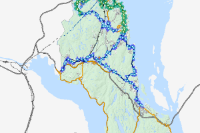

Int64Index([799], dtype='int64')
	Error copying  NARING_ForetakPunkt_Asker_ALLE
	('Failed to create Feature Service NARING_ForetakPunkt_Asker_ALLE: \nField firemail has invalid html content.\n(Error Code: 400)', <Item title:"NARING_ForetakPunkt_Asker_ALLE" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>)
	Removing Feature Service NARING_ForetakPunkt_Asker_ALLE


<Item title:"meter400_rundt10til30minFrekvensBusstopp_DISSOLVED_copy" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
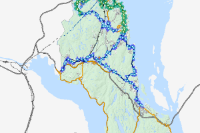

Int64Index([756], dtype='int64')


<Item title:"N50_Arealdekke_AskerOmegn_HavOgElv" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
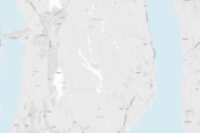

Int64Index([1277], dtype='int64')
	Error copying  GeomapMatrikkelEierWFS
	('Failed to create Feature Service GeomapMatrikkelEierWFS: Error performing query operation\n(Error Code: 500)', <Item title:"GeomapMatrikkelEierWFS" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>)
	Removing Feature Service GeomapMatrikkelEierWFS


<Item title:"N50_Arealdekke_AskerOmegn_HavOgElv" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
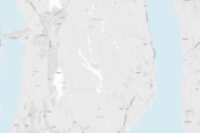

Int64Index([156], dtype='int64')


<Item title:"Risenga_multipatchv3_utm32" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
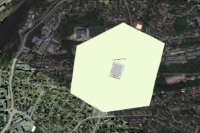

Int64Index([853], dtype='int64')


<Item title:"AADT_Asker_CopyFeatures_CopyFeatures2" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
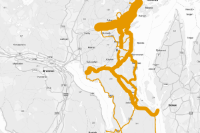

Int64Index([1192], dtype='int64')
	Error copying  Bratthet_v4
	<!DOCTYPE html PUBLIC "-//W3C//DTD XHTML 1.0 Strict//EN" "http://www.w3.org/TR/xhtml1/DTD/xhtml1-strict.dtd">
<html xmlns="http://www.w3.org/1999/xhtml">
<head>
<meta http-equiv="Content-Type" content="text/html; charset=iso-8859-1"/>
<title>404 - File or directory not found.</title>
<style type="text/css">
<!--
body{margin:0;font-size:.7em;font-family:Verdana, Arial, Helvetica, sans-serif;background:#EEEEEE;}
fieldset{padding:0 15px 10px 15px;} 
h1{font-size:2.4em;margin:0;color:#FFF;}
h2{font-size:1.7em;margin:0;color:#CC0000;} 
h3{font-size:1.2em;margin:10px 0 0 0;color:#000000;} 
#header{width:96%;margin:0 0 0 0;padding:6px 2% 6px 2%;font-family:"trebuchet MS", Verdana, sans-serif;color:#FFF;
background-color:#555555;}
#content{margin:0 0 0 2%;position:relative;}
.content-container{background:#FFF;width:96%;margin-top:8px;padding:10px;position:relative;}
-->
</style>
</head>
<body>
<div id="header"><h1>Server Error</h1>

<Item title:"AADT_Asker_CopyFeatures_CopyFeatures2" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
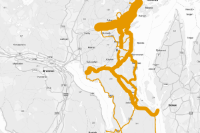

IndexError: list index out of range

In [140]:
#Clon feature service for Stemme

for i in range(len(diff_fs)):
    diff=df1[df1['title']==diff_fs[i]]
    target_index= diff.index
    print(target_index)
    for i in target_index:

        source_data = content_df.loc[i].id
        #print(target_data)
        source_content = source.content.get(source_data)

        #find item's owner
        source_item_owner = source.users.search(source_content.owner)[0]
        #find item's folder
        item_folder_titles = [f['title'] for f in source_item_owner.folders 
                              if f['id'] == source_content.ownerFolder]
        folder_name = None
        if len(item_folder_titles) > 0:
            folder_name = item_folder_titles[0]

        #if folder does not exist for target user, create it
        if folder_name:
            target_user = target.users.search('Stemme')[0]
          #  target_user = target.users.search(source_content.owner)[0]
            target_user_folders = [f['title'] for f in target_user.folders
                                   if f['title'] == folder_name]
            if len(target_user_folders) == 0:
                #create the folder
                target.content.create_folder(folder_name, target_user.username)
        try:
            cloned_items = target.content.clone_items([source_content], copy_data=True, search_existing_items=True, owner=target_user, folder=folder_name)
        except Exception as ex:
            print("\tError copying ", str(source_content.title))
            print("\t" + str(ex))
            print("\tRemoving Feature Service", str(source_content.title))
            diff_fs.remove(source_content.title)
            pass
        for ci in cloned_items:
            display(ci)
        if source_content.access == "org":
            ci.share(everyone=False, org=True)
        else:
            ci.share(everyone=True, org=False)
  
    

Int64Index([244], dtype='int64')


<Item title:"valg_enkelttall" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
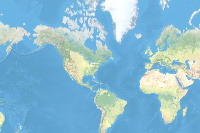

<Item title:"alle_tall_Asker_valg_enkelttall_valgkrets" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
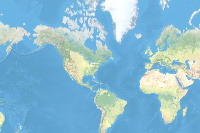

<Item title:"Stortingsvalg2021_forhaandsstemmer_VALGDAG_versjon_5" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
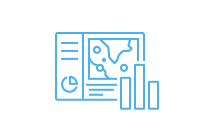

Int64Index([218], dtype='int64')


<Item title:"alle_tall_Asker_valg" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
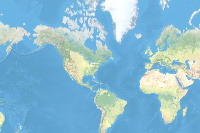

<Item title:"Stortingsvalg2021_forhaandsstemmer (kopi)_farger2" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
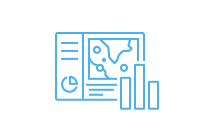

Int64Index([308], dtype='int64')


<Item title:"Koronadashboard Fullversjon Alle Faner GJELDENDE 0605_2021_kopi_08032022" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
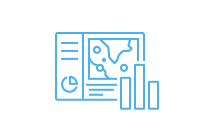

Int64Index([494], dtype='int64')


<Item title:"Corona Testede Smittede bl KOPI_v2" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
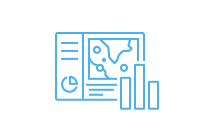

Int64Index([1004], dtype='int64')


<Item title:"Cortonadashboard test faner samlet (copy) FARGETEST" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
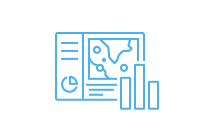

Int64Index([476], dtype='int64')


<Item title:"Corona dashboard test Om data/Metadata KOPI med logo lenker" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
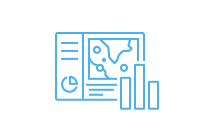

Int64Index([1017], dtype='int64')


<Item title:"Calls for Service Dashboard" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
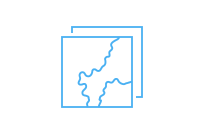

<Item title:"Daily Activity Dashboard" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
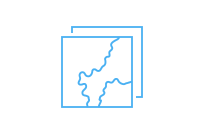

<Item title:"Arrest Dashboard" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
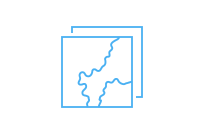

<Item title:"Daily Activity Dashboard" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
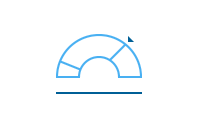

Int64Index([774], dtype='int64')


<Item title:"Næring_statistikk_bygg" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
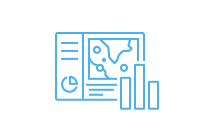

Int64Index([1309], dtype='int64')


<Item title:"Grunnundersøkelser Asker_kopi_2803_2022" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
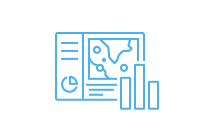

Int64Index([227], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_uten_kart_bare_tall" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
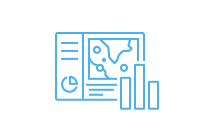

Int64Index([235], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_VALGDAG_stemmekretser_kake_valgdag" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
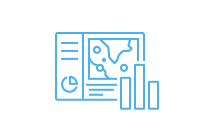

Int64Index([320], dtype='int64')


<Item title:"vaksine_kakediagram" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
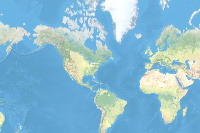

<Item title:"vaksine_aldersfordelt_v2" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
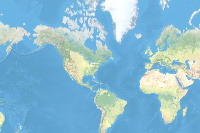

<Item title:"forventede_vaksinedoser_v2" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
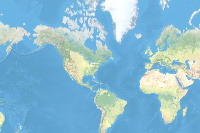

<Item title:"vaksine_enkelttall" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
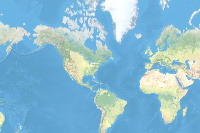

<Item title:"Koronadashboard Vaksinerte GJELDENDE 0605_2021_3vaksinerTildelt" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
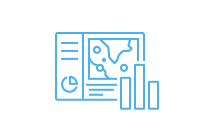

Int64Index([220], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_grafer" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
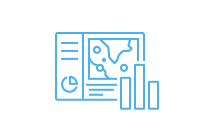

Int64Index([315], dtype='int64')


<Item title:"smitte_14dager_aldersfordeling_kjonn" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
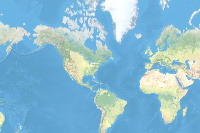

<Item title:"Koronadashboard Smittede kjønn" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
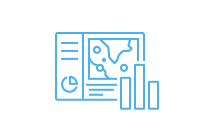

Int64Index([232], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_uten_kart_Sist_oppdatert" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
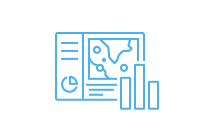

Int64Index([328], dtype='int64')


<Item title:"vaksine_aldersfordelt" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
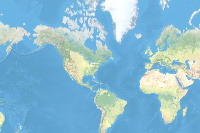

<Item title:"Koronadashboard Vaksinerte GJELDENDE 0605_2021_test_forventeedeVaksinedoser" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
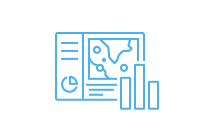

Int64Index([221], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_grafer_kakediagram" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
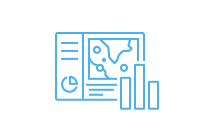

Int64Index([1310], dtype='int64')


<Item title:"Grunnundersøkelser Asker_kopi_kvikkleire" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
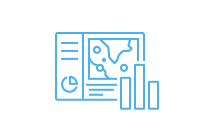

Int64Index([474], dtype='int64')


<Item title:"Coronadashboard_webmap" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
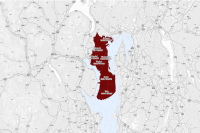

<Item title:"Corona dashboard Smitttede alder Kjønn Bosted blå KOPI" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
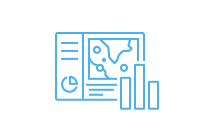

Int64Index([487], dtype='int64')


<Item title:"Corona hoveddashboard test Smittede (copy) Den som brukes (?) (copy) KOPI NY DESIGN TEST" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
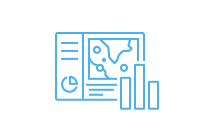

Int64Index([296], dtype='int64')


<Item title:"teste" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>

Int64Index([222], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_grafer_speedometer" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
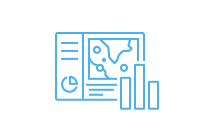

Int64Index([224], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_original" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
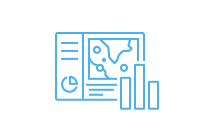

Int64Index([242], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_VALGDAG_versjon_3" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
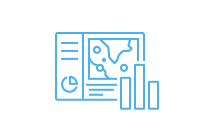

Int64Index([219], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer (kopi)_gamlefarger" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
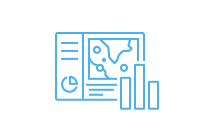

Int64Index([489], dtype='int64')


<Item title:"Corona hoveddashboard test Smittede (copy) Den som brukes (?) Kopi_original_testede_tabeller" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
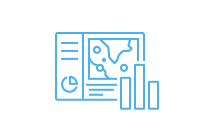

Int64Index([234], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_VALGDAG_stemmekretser" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
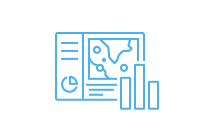

Int64Index([481], dtype='int64')


<Item title:"Corona dashboard test Vaksinerte NY (copy) KOPI NYTT DESIGN TEST" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
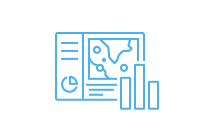

Int64Index([237], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_VALGDAG_stemmekretser_speedometer_forhånds (kopi)" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
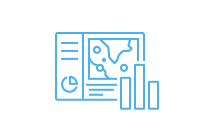

Int64Index([324], dtype='int64')


<Item title:"Koronadashboard Vaksinerte GJELDENDE 0605_2021_KOPI_17_02_2022" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
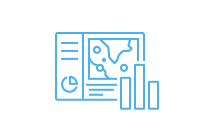

Int64Index([325], dtype='int64')


<Item title:"Koronadashboard Vaksinerte GJELDENDE 0605_2021_kopi_forventede_vaksinedoser" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
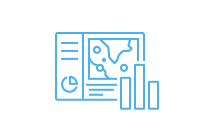

Int64Index([327], dtype='int64')


<Item title:"Koronadashboard Vaksinerte GJELDENDE 0605_2021_Kopi_sept21_versjon2" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
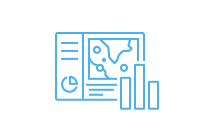

Int64Index([1018], dtype='int64')


<Item title:"Firkant_minusAsker" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
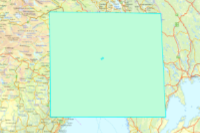

<Item title:"Flate_Asker" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
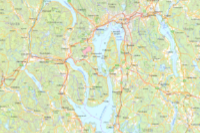

<Item title:"Askerflate_minusSjø_Dissolve" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
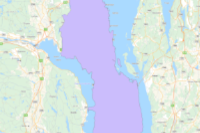

<Item title:"Vann_innadAsker_ikkeSjø" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
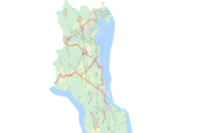

<Item title:"Bane" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
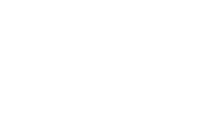

<Item title:"Lokalområde_aldersstatistikk_69til79" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>
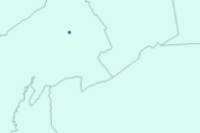

<Item title:"KART: Lokalområder-Copy fra Rebekka LYDIA" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
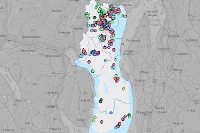

<Item title:"Dashboard Lydia" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
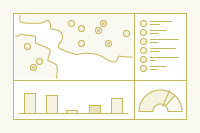

Int64Index([225], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_Soylediagram" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
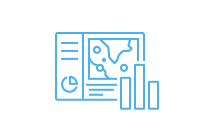

Int64Index([294], dtype='int64')


<Item title:"smitte_full" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
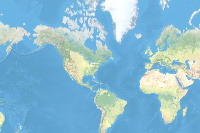

<Item title:"Smitte_enkelttall" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
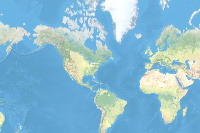

<Item title:"test_på_hastighet" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
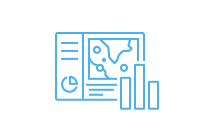

Int64Index([776], dtype='int64')
	Error copying  Næring_statistikk_test_14_06_2022_TEST2
	('Failed to create Feature Service Næring_foretakspunkt_ikkeENKOver0ansatte: \nField firemail has invalid html content.\n(Error Code: 400)', <Item title:"Næring_foretakspunkt_ikkeENKOver0ansatte" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>)
	Removing Dashboard Næring_statistikk_test_14_06_2022_TEST2


<Item title:"smitte_full" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
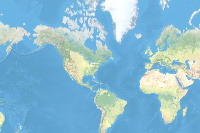

<Item title:"Smitte_enkelttall" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
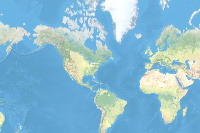

<Item title:"test_på_hastighet" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
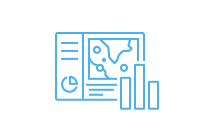

Int64Index([475], dtype='int64')


<Item title:"Corona dashboard test Om data/Metadata" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
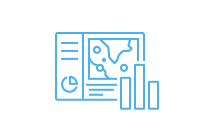

Int64Index([241], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_VALGDAG_versjon_2" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
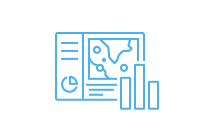

Int64Index([307], dtype='int64')


<Item title:"Koronadashboard Fullversjon Alle Faner GJELDENDE 0605_2021-KOPI_KART_FØRST" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
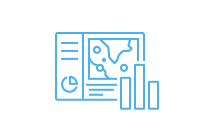

Int64Index([699], dtype='int64')


<Item title:"Korona_smittede_14_dager_stolpediagram" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
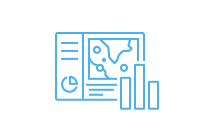

Int64Index([309], dtype='int64')


<Item title:"Koronadashboard Fullversjon Alle Faner GJELDENDE 0605_2021_KOPI_17_02_2022" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
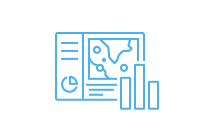

Int64Index([314], dtype='int64')


<Item title:"Coronadashboard_webmap_mobilversjon" type:Web Map owner:Asmund.Stemme@asker.kommune.no_askereu>
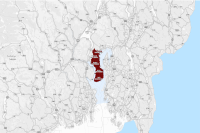

<Item title:"Koronadashboard Smittede KART" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
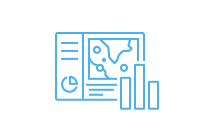

Int64Index([223], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_med_kakediagrammer" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
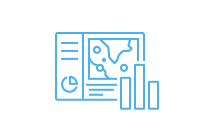

Int64Index([319], dtype='int64')


<Item title:"Koronadashboard Vaksinerte GJELDENDE 0605_2021 KOPI_SLETTMEG" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
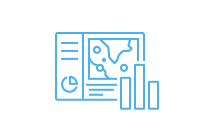

Int64Index([323], dtype='int64')


<Item title:"Koronadashboard Vaksinerte GJELDENDE 0605_2021_kopi_03012022" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
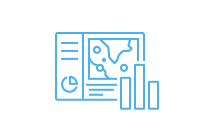

Int64Index([478], dtype='int64')


<Item title:"Corona dashboard test Smittede alder kjønn (copy) TEST FANER" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
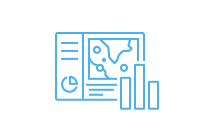

Int64Index([326], dtype='int64')


<Item title:"vaksinerte_12_15" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>

<Item title:"Koronadashboard Vaksinerte GJELDENDE 0605_2021_Kopi_sept21" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
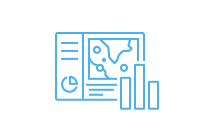

Int64Index([485], dtype='int64')


<Item title:"Corona hoveddashboard Smittede Testede blå KOPI" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
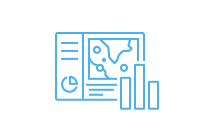

Int64Index([495], dtype='int64')


<Item title:"smitte_14dager_kjonn_alder_IKKEBRUK" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
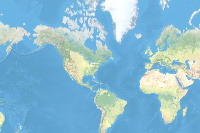

<Item title:"Coronadashboard Fordeling KjønnAlderBosted kopi av gjeldende CSVtest" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
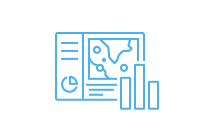

Int64Index([1306], dtype='int64')


<Item title:"Grunnundersøkelser Asker" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
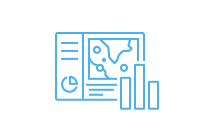

Int64Index([321], dtype='int64')


<Item title:"Koronadashboard Vaksinerte GJELDENDE 0605_2021_dose3_utkast" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
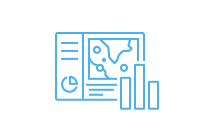

Int64Index([491], dtype='int64')


<Item title:"Corona hoveddashboard test Smittede (copy)_KOPI" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
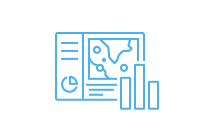

Int64Index([310], dtype='int64')


<Item title:"Koronadashboard Smittede Alder/" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
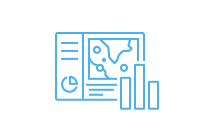

Int64Index([490], dtype='int64')


<Item title:"Corona hoveddashboard test Smittede (copy) MED KART" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
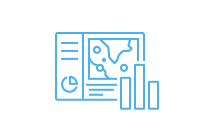

Int64Index([496], dtype='int64')


<Item title:"testede_full" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
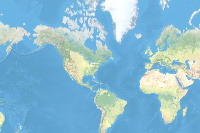

<Item title:"testede_enkelttall" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
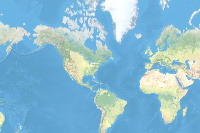

<Item title:"testede_14dager" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
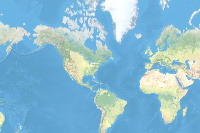

<Item title:"Coronadashboard SmittedeTestede kopi av gjeldende CSVtest" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
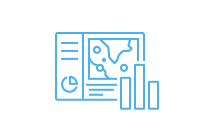

Int64Index([777], dtype='int64')
	Error copying  Næring_statistikk_test_14_06_2022_TEST3
	('Failed to create Feature Service NARING_ForetakPunkt_Asker_ALLE: \nField firemail has invalid html content.\n(Error Code: 400)', <Item title:"NARING_ForetakPunkt_Asker_ALLE" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>)
	Removing Dashboard Næring_statistikk_test_14_06_2022_TEST3


<Item title:"testede_full" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
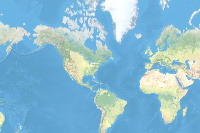

<Item title:"testede_enkelttall" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
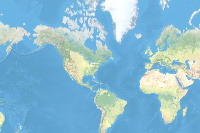

<Item title:"testede_14dager" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
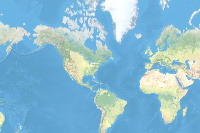

<Item title:"Coronadashboard SmittedeTestede kopi av gjeldende CSVtest" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
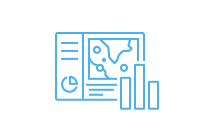

Int64Index([331], dtype='int64')


<Item title:"Koronadashboard Vaksinerte_12_15" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
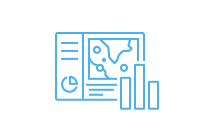

Int64Index([333], dtype='int64')


<Item title:"Koronadashboard_mobilversjon_vaksineAldersfordelt" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
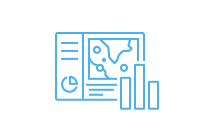

Int64Index([239], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_VALGDAG_stemmetall" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
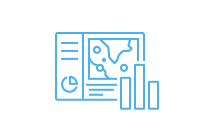

Int64Index([367], dtype='int64')


<Item title:"kpi_ict" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
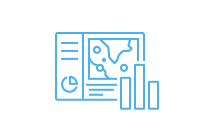

Int64Index([334], dtype='int64')


<Item title:"Koronadashboard_mobilversjon_vaksineAldersfordelt (kopi)" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
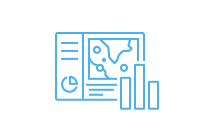

Int64Index([226], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_uten_kart" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
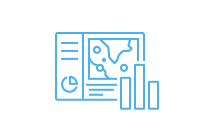

Int64Index([1003], dtype='int64')


<Item title:"Cortonadashboard Faner samlet blå KOPI" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
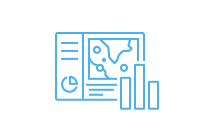

Int64Index([330], dtype='int64')


<Item title:"vaksine_aldersfordel_dummyMedNull" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
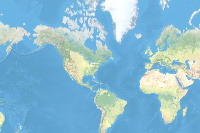

<Item title:"Koronadashboard Vaksinerte TEST_aldersfordelt_uten_null" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
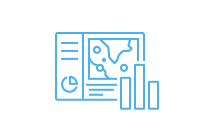

Int64Index([302], dtype='int64')


<Item title:"testede_14dager_v2" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
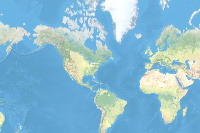

<Item title:"Korona_testede_14_dager_stolpediagram" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
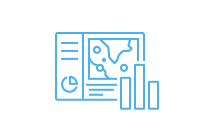

Int64Index([477], dtype='int64')


<Item title:"Corona dashboard test Smittede alder kjønn (copy) KOPI NYTT DESIGN TEST" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
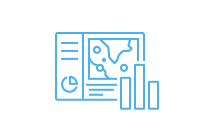

Int64Index([492], dtype='int64')


<Item title:"Corona hoveddashboard test Smittede (copy)_slettekopi" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
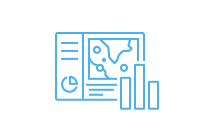

Int64Index([1149], dtype='int64')


<Item title:"Barometer_kun_bilde" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
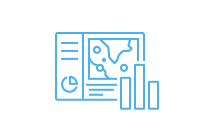

Int64Index([317], dtype='int64')


<Item title:"innbyggertall_asker" type:Table Layer owner:Asmund.Stemme@asker.kommune.no_askereu>
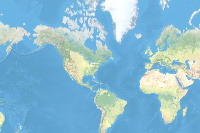

<Item title:"Koronadashboard Smittede Testede GJELDENDE 0605_2021_slettmeg" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
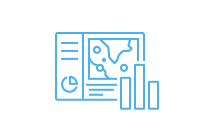

Int64Index([488], dtype='int64')


<Item title:"Corona hoveddashboard test Smittede (copy) Den som brukes (?) (kopi2804" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
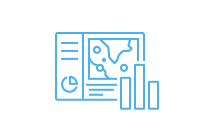

Int64Index([243], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_VALGDAG_versjon_3 (kopi)" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
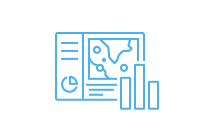

Int64Index([238], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_VALGDAG_stemmekretser_speedometer_valgdag" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
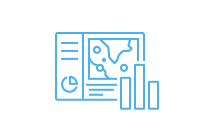

Int64Index([336], dtype='int64')


<Item title:"Koronadsaboard_mobilversjon_vaksinetall" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
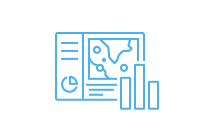

Int64Index([311], dtype='int64')


<Item title:"Koronadashboard Smittede Alder/kjønn/bostedsfordeling GJELDENDE 0605_2021 (kopi)wqsafdd" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
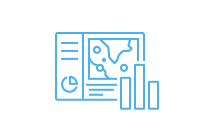

Int64Index([236], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_VALGDAG_stemmekretser_speedometer_forhånds" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
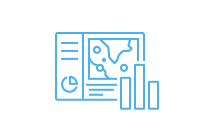

Int64Index([228], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_uten_kart_bare_tall (kopi)" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
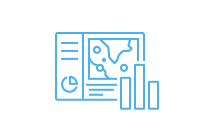

Int64Index([229], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_uten_kart_bare_tall_to" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
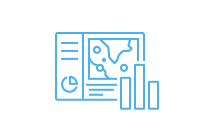

Int64Index([318], dtype='int64')


<Item title:"Koronadashboard Vaksinerte GJELDENDE 0605_2021 (kopi)" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
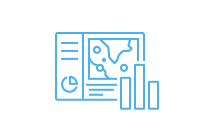

Int64Index([230], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_uten_kart_bare_tall_tre" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
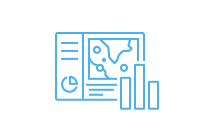

Int64Index([313], dtype='int64')


<Item title:"Koronadashboard Smittede Alder/kjønn/bostedsfordeling GJELDENDE 0605_2021_KOPI_MEDSISTE_TO_UKER" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
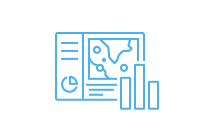

Int64Index([622], dtype='int64')


<Item title:"indicator test" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
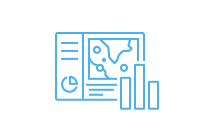

Int64Index([231], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_uten_kart_kopi_av_ORIGINAL_10092021" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
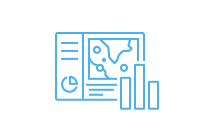

Int64Index([775], dtype='int64')
	Error copying  Næring_statistikk_test_14_06_2022
	('Failed to create Feature Service Næring_foretakspunkt_ikkeENKOver0ansatte: \nField firemail has invalid html content.\n(Error Code: 400)', <Item title:"Næring_foretakspunkt_ikkeENKOver0ansatte" type:Feature Layer Collection owner:Asmund.Stemme@asker.kommune.no_askereu>)
	Removing Dashboard Næring_statistikk_test_14_06_2022


<Item title:"Stortingsvalg2021_forhaandsstemmer_uten_kart_kopi_av_ORIGINAL_10092021" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
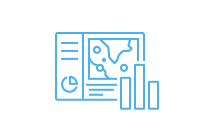

Int64Index([1307], dtype='int64')


<Item title:"Grunnundersøkelser Asker (kopi)" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
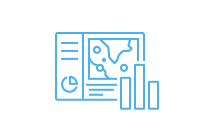

Int64Index([339], dtype='int64')


<Item title:"Koronadsaboard_mobilversjon_vaksinetall_v3" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
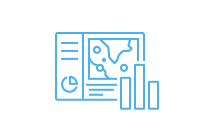

Int64Index([480], dtype='int64')


<Item title:"Corona dashboard test Vaksinerte" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
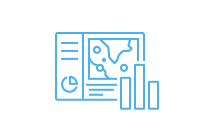

Int64Index([240], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_VALGDAG_uten_uten_antallPerValkrets" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
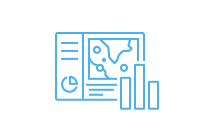

Int64Index([486], dtype='int64')


<Item title:"Corona hoveddashboard test Smittede" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
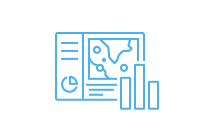

Int64Index([329], dtype='int64')


<Item title:"Koronadashboard Vaksinerte TEST_aldersfordelt_med_null" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
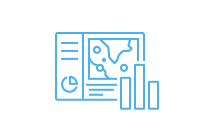

Int64Index([497], dtype='int64')


<Item title:"Coronadashboard Vaksinerte kopi av gjeldende CSVtest" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
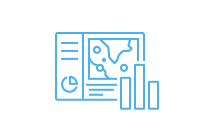

Int64Index([233], dtype='int64')


<Item title:"Stortingsvalg2021_forhaandsstemmer_VALGDAG" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
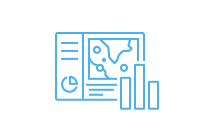

Int64Index([493], dtype='int64')


<Item title:"Corona hoveddashboard test Smittede (copy)_slettetest" type:Dashboard owner:Asmund.Stemme@asker.kommune.no_askereu>
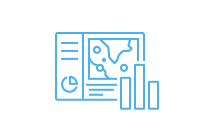

IndexError: list index out of range

In [176]:
#Clon dashboard for Stemme

for i in range(len(diff_list_dash)):
    diff=df1[df1['title']==diff_list_dash[i]]
    target_index= diff.index
    print(target_index)
    for i in target_index:

        source_data = content_df.loc[i].id
        #print(target_data)
        source_content = source.content.get(source_data)

        #find item's owner
        source_item_owner = source.users.search(source_content.owner)[0]
        #find item's folder
        item_folder_titles = [f['title'] for f in source_item_owner.folders 
                              if f['id'] == source_content.ownerFolder]
        folder_name = None
        if len(item_folder_titles) > 0:
            folder_name = item_folder_titles[0]

        #if folder does not exist for target user, create it
        if folder_name:
            target_user = target.users.search('Stemme')[0]
          #  target_user = target.users.search(source_content.owner)[0]
            target_user_folders = [f['title'] for f in target_user.folders
                                   if f['title'] == folder_name]
            if len(target_user_folders) == 0:
                #create the folder
                target.content.create_folder(folder_name, target_user.username)
        try:
            cloned_items = target.content.clone_items([source_content], copy_data=True, search_existing_items=True, owner=target_user, folder=folder_name)
        except Exception as ex:
            print("\tError copying ", str(source_content.title))
            print("\t" + str(ex))
            print("\tRemoving Dashboard", str(source_content.title))
            diff_list_dash.remove(source_content.title)
            pass
        for ci in cloned_items:
            display(ci)
        if source_content.access == "org":
            ci.share(everyone=False, org=True)
        else:
            ci.share(everyone=True, org=False)

### Cleaning target dataframe

In [91]:
#Delete target Feature Service layers
try:
    fs_index= tar_content_df[combined_mask].index
    for i in fs_index:
        fs_data = tar_content_df.loc[i].id
        print(fs_data)
        fs_content = target.content.get(fs_data)
        fs_content.delete()
except Exception as ex:
    print("\tError copying ", str(fs_content))
    print("\t" + str(ex))
    pass

C:\Users\glinares\AppData\Local\Temp\ipykernel_15960\4138998200.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  fs_index= tar_content_df[combined_mask].index


d00abf0acd74478eb6bacb2630802fb5
b44b7e552fc74f008967533878cb4fe7
bf89dc6d239743deb3aa6871abe1aa82
786a123b9ba4477b928c629ec1279d2e
43f2896b91994c73bc7c6c7b5bdb74a0
76162eef39f5403ba15a22d8ed63dedc
ed49a6dd37db4fc6806b63e2507cd554
a32bf9ecbdb54c3c878648cc925026d6
f13e1eee11994ea2bd587d455515389f
9c6144e4a1fe465cb452ea6cc073e55a
9dd902224a0a41b7836b4046c7c59c18
67391c19c2c14685b091682f219d029d
72ac667841154baeb897e652a24a4ce1
47789acd1b0c4d09ace58e37aa6ee760
8317702c13ae42b7a3972cc0e8291d7a
9fa8d3de340644478272f48b8db03a2e
05676877e7a444f194e16aa2ac2bc838
c72005c8567441a7af7a81aaa25e5a14
747ba7bcfaf641d4a2e316809a415c58
3a4ef22f83824fdaad0ad780e968af1a
e3148435110649459b90e7b9b60f4875
346596a2531d4fcabe80663b1b59015c
db1c319c29f2499e85e12879a987eccb
749d83206e984b5590ae4ed54fa965a7
0b3db263f499415f8e5782bf2fdb76fb
eb59c6f515fa4394b57c172670aabb30
e91ec82a1dd54acb9347d1a708899c82
025d6ff553a2493b8f08d3215a6a45c9
479919f3fc5747dc86cb7fe986b8440a
8282a2fc993a4e7490911bd07c5e73b4
381172a23c

### Cloning items for all users by type

Int64Index([804], dtype='int64')


<Item title:"ssn_ispshavneanlegg" type:Feature Layer Collection owner:giselle.linares_askereu>
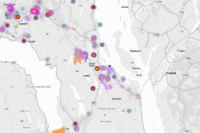

Int64Index([436], dtype='int64')


<Item title:"BygningerMedTekstur_NY_utm32_v9" type:Feature Layer Collection owner:giselle.linares_askereu>
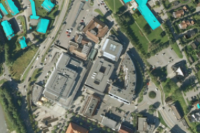

Int64Index([196], dtype='int64')


<Item title:"Smittede_2204_siste14dager_ExcelToTable" type:Table Layer owner:giselle.linares_askereu>
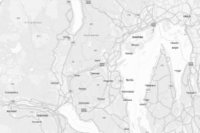

Int64Index([463], dtype='int64')


<Item title:"bygningsflater_overvannsanalyse_290621" type:Feature Layer Collection owner:giselle.linares_askereu>
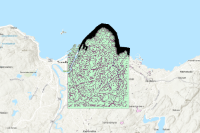

Int64Index([1133], dtype='int64')


<Item title:"Olav_Brunborgs_vei_Bygninger" type:Feature Layer Collection owner:giselle.linares_askereu>
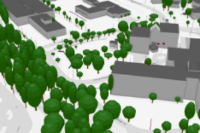

Int64Index([1276], dtype='int64')


_ItemCreateException: ('Failed to create Feature Service GeomapMatrikkelEierWFS: Error performing query operation\n(Error Code: 500)', <Item title:"GeomapMatrikkelEierWFS" type:Feature Layer Collection owner:giselle.linares_askereu>)

In [413]:
#Clon Feature Service all
for i in range(len(diff_list_fs)):
    diff=fs_source[fs_source['title']==diff_list_fs[i]]
    target_index= diff.index
    print(target_index)
    for i in target_index:
        source_data = content_df.loc[i].id
        #print(target_data)
        source_content = source.content.get(source_data)

        #find item's owner
        source_item_owner = source.users.search(source_content.owner)[0]
        #find item's folder
        item_folder_titles = [f['title'] for f in source_item_owner.folders 
                              if f['id'] == source_content.ownerFolder]
        folder_name = None
        if len(item_folder_titles) > 0:
            folder_name = item_folder_titles[0]

        #if folder does not exist for target user, create it
        if folder_name:
            target_user = target.users.search(source_content.owner.split('.')[0])[0]
            target_user_folders = [f['title'] for f in target_user.folders
                                   if f['title'] == folder_name]
            if len(target_user_folders) == 0:
                #create the folder
                target.content.create_folder(folder_name, target_user.username)
        cloned_items = target.content.clone_items([source_content], copy_data=True, search_existing_items=True, folder=folder_name) 
        for ci in cloned_items:
            display(ci)
        if source_content.access == "org":
            ci.share(everyone=False, org=True, groups=target_group.id)
        else:
            ci.share(everyone=True, org=False, groups=target_group.id)

<Item title:"Polygoner" type:Service Definition owner:giselle.linares_askereu>
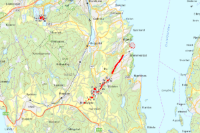

<Item title:"Polygonlag_test_storymap" type:Service Definition owner:giselle.linares_askereu>
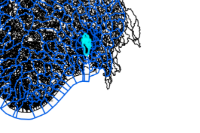

<Item title:"Punkter 4 juli" type:Service Definition owner:giselle.linares_askereu>
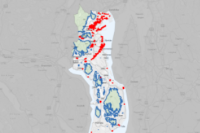

<Item title:"Punkter_14iuni_TEST_UTM33" type:Service Definition owner:giselle.linares_askereu>
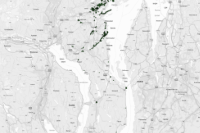

<Item title:"RegineEnhet_Vi" type:Service Definition owner:giselle.linares_askereu>
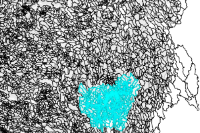

<Item title:"Regionalnett" type:Service Definition owner:giselle.linares_askereu>
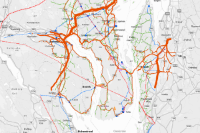

<Item title:"regplan_crop_png_png" type:Service Definition owner:giselle.linares_askereu>
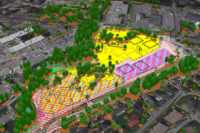

<Item title:"Regulerte hyttetomter BEBYGD" type:Service Definition owner:giselle.linares_askereu>
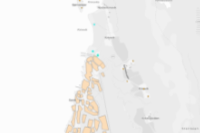

<Item title:"Regulerte hyttetomter UBEBYGD" type:Service Definition owner:giselle.linares_askereu>
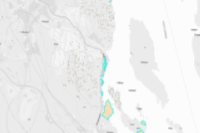

<Item title:"Risenga_multipatchv3_utm32" type:Service Definition owner:giselle.linares_askereu>
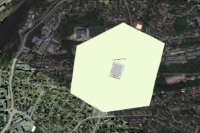

<Item title:"Risenga_multipatchv3_utm32_to_utm33" type:Service Definition owner:giselle.linares_askereu>
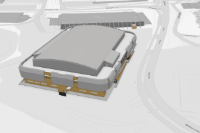

<Item title:"RpArealformål1120_RbFormål_150_flate_FRITIDSBEBYGGELSE" type:Service Definition owner:giselle.linares_askereu>
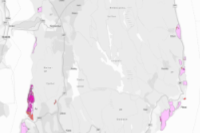

<Item title:"Sentralnett" type:Service Definition owner:giselle.linares_askereu>
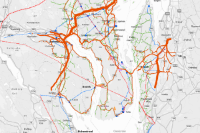

<Item title:"SLL_ID1_Makshastighet_tif" type:Service Definition owner:giselle.linares_askereu>
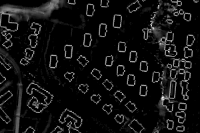

<Item title:"SLL_ID1_Makshastighet_tif_histohgramstretch" type:Service Definition owner:giselle.linares_askereu>
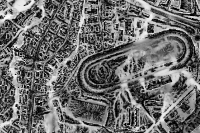

<Item title:"SLL_ID1_Makshastighet_tif_histostretch" type:Service Definition owner:giselle.linares_askereu>
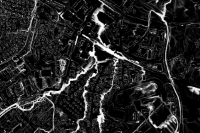

<Item title:"SLL_ID1_Maksvanndyp_tif" type:Service Definition owner:giselle.linares_askereu>
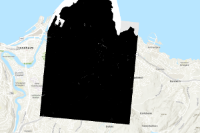

<Item title:"SLL_ID1_Maksvanndyp_tif_histogramstretch" type:Service Definition owner:giselle.linares_askereu>
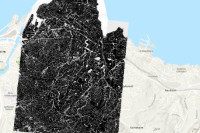

<Item title:"SLL_ID1_VannretningTS90_tif" type:Service Definition owner:giselle.linares_askereu>
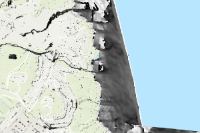

<Item title:"Smittede_14dager_kjønnsfordelt_2204_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
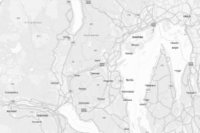

<Item title:"smittede_2204_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
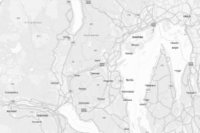

<Item title:"Smittede_2204_siste14dager_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
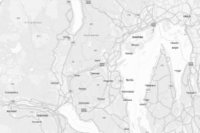

<Item title:"smittede_rensket_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
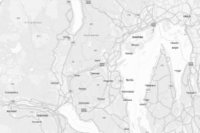

<Item title:"koronatestingdagfordagfrastart_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
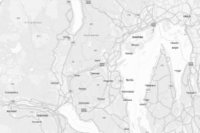

<Item title:"KpArealformaalOmraade_kommuneplanforslag2022_utm33_v3" type:Service Definition owner:giselle.linares_askereu>
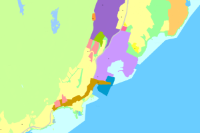

<Item title:"KpArealformålOmråde_CopyFeaturesBebygd" type:Service Definition owner:giselle.linares_askereu>
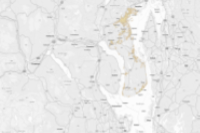

<Item title:"KpArealformålOmråde_CopyFeaturesGroent" type:Service Definition owner:giselle.linares_askereu>
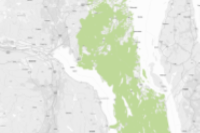

<Item title:"KpArealformålOmråde_kommuneplanforslag2022" type:Service Definition owner:giselle.linares_askereu>
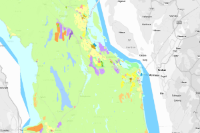

<Item title:"KpArealformålOmråde_kommuneplanforslag2022_utm33_1300" type:Service Definition owner:giselle.linares_askereu>
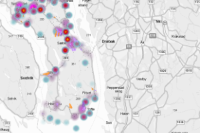

<Item title:"KpArealformålOmråde_kommuneplanforslag2022_utm33_1300_1500_1800" type:Service Definition owner:giselle.linares_askereu>
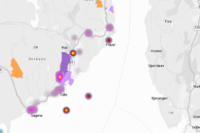

<Item title:"KpArealformålOmråde_kommuneplanforslag2022_utm33_1300_1500_1800_AREALTALL" type:Service Definition owner:giselle.linares_askereu>
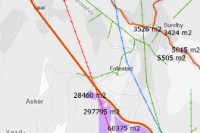

<Item title:"KpArealformålOmråde_kommuneplanforslag2022_utm33_1300_1500_1800_v2" type:Service Definition owner:giselle.linares_askereu>
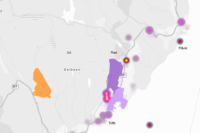

<Item title:"KpArealformålOmråde_kommuneplanforslag2022_utm33_1300_1500_1800_v3" type:Service Definition owner:giselle.linares_askereu>
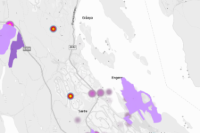

<Item title:"KpArealformålOmråde_LNF" type:Service Definition owner:giselle.linares_askereu>
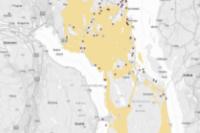

<Item title:"KpArealformålOmråde_LNF_alt_" type:Service Definition owner:giselle.linares_askereu>
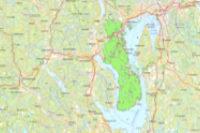

<Item title:"KpJuridiskLinje_line_Strandlinje" type:Service Definition owner:giselle.linares_askereu>
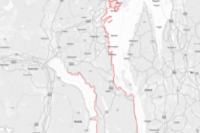

<Item title:"KpJuridiskLinje_line_Strandsone" type:Service Definition owner:giselle.linares_askereu>
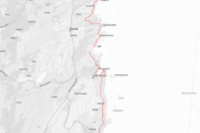

<Item title:"KpPåskrift_text_ny_kommuneplan_2022" type:Service Definition owner:giselle.linares_askereu>
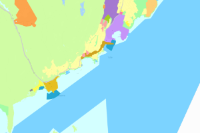

<Item title:"KpPåskrift_text_ny_kommuneplan_2022_utm33" type:Service Definition owner:giselle.linares_askereu>
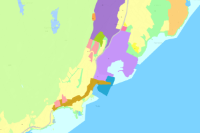

<Item title:"KpPåskrift_text_ny_kommuneplanforslag2022_utm33" type:Service Definition owner:giselle.linares_askereu>
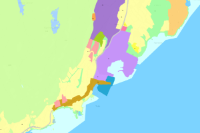

<Item title:"Kulturmiljoer" type:Service Definition owner:giselle.linares_askereu>
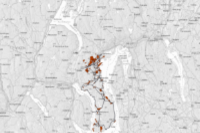

<Item title:"LNF_Asker" type:Service Definition owner:giselle.linares_askereu>
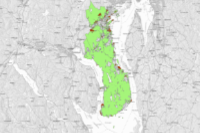

<Item title:"LNF_Asker_v2" type:Service Definition owner:giselle.linares_askereu>
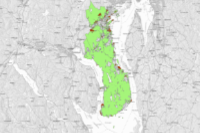

<Item title:"Lokalomr_test" type:Service Definition owner:giselle.linares_askereu>
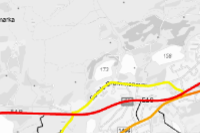

<Item title:"44_PNG_testlag" type:Service Definition owner:giselle.linares_askereu>
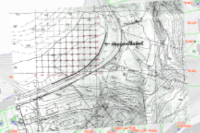

<Item title:"AADT_Asker" type:Service Definition owner:giselle.linares_askereu>
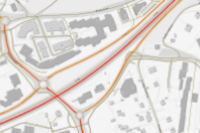

<Item title:"AADT_Asker_CopyFeatures_CopyFeatures2" type:Service Definition owner:giselle.linares_askereu>
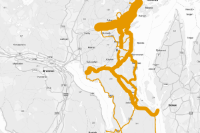

<Item title:"AADT_Asker_str_farge" type:Service Definition owner:giselle.linares_askereu>
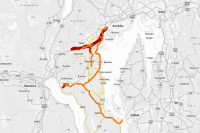

<Item title:"AAmotaasen_IfcBuildingElementProxy_surface_copy_utm33_v5" type:Service Definition owner:giselle.linares_askereu>
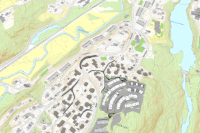

<Item title:"ADMIN_DelomradeFlateASKER_2019" type:Service Definition owner:giselle.linares_askereu>
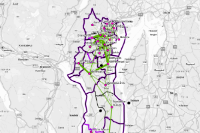

<Item title:"ADMIN_DelomradePointASKER_2019" type:Service Definition owner:giselle.linares_askereu>
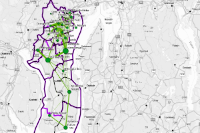

<Item title:"Annen fritidseiendom matrikkelbyggpunkt" type:Service Definition owner:giselle.linares_askereu>
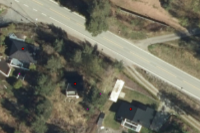

<Item title:"antall_smittede_kjønn_alder_14dager_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
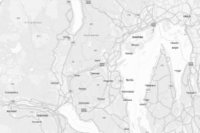

<Item title:"AR5_basert_FKB_vann" type:Service Definition owner:giselle.linares_askereu>
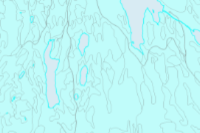

<Item title:"AR5_flate_2021" type:Service Definition owner:giselle.linares_askereu>
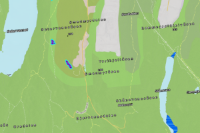

<Item title:"AR5_flate_21_FulldyrkaMark" type:Service Definition owner:giselle.linares_askereu>
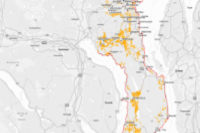

<Item title:"AR5_flate_Vann_elv" type:Service Definition owner:giselle.linares_askereu>
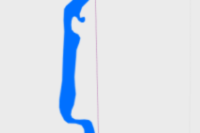

<Item title:"AR5_flate_VEI" type:Service Definition owner:giselle.linares_askereu>
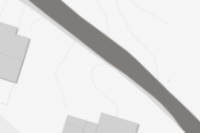

<Item title:"AR5_flate_VEI_tile" type:Service Definition owner:giselle.linares_askereu>
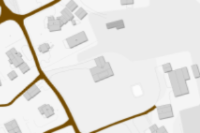

<Item title:"AR5_flate_VEI_vectortile" type:Service Definition owner:giselle.linares_askereu>
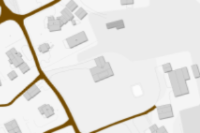

<Item title:"AR5_Myr_endretKP2022" type:Service Definition owner:giselle.linares_askereu>
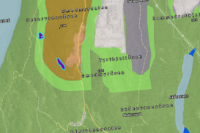

<Item title:"Bygninger3D_Asker_Naering" type:Service Definition owner:giselle.linares_askereu>
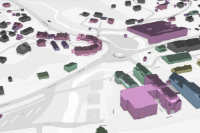

<Item title:"Bygninger3D_Asker_Naering_v2" type:Service Definition owner:giselle.linares_askereu>
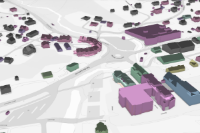

<Item title:"Bygninger_graa_kun_trekanten_v2" type:Service Definition owner:giselle.linares_askereu>
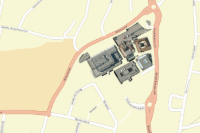

<Item title:"Bygninger_graa_uten_Trekanten_v2" type:Service Definition owner:giselle.linares_askereu>
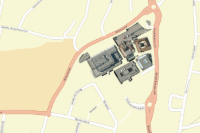

<Item title:"Bygninger_kun_Gammel_Trekanten" type:Service Definition owner:giselle.linares_askereu>
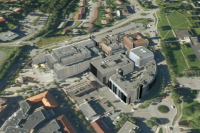

<Item title:"Bygninger_slett_meg" type:Service Definition owner:giselle.linares_askereu>
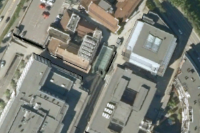

<Item title:"Bygninger_symbolisert_felt_strandsone" type:Service Definition owner:giselle.linares_askereu>
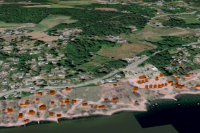

<Item title:"Bygninger_tekstur_kun_Trekanten_v2" type:Service Definition owner:giselle.linares_askereu>
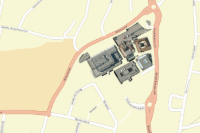

<Item title:"Bygninger_tekstur_minus_Trekanten_v2" type:Service Definition owner:giselle.linares_askereu>
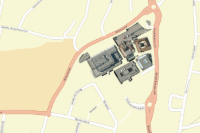

<Item title:"Bygninger_uten_Gammel_Trekanten" type:Service Definition owner:giselle.linares_askereu>
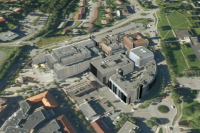

<Item title:"BygningerMedTekstur_ALLE" type:Service Definition owner:giselle.linares_askereu>
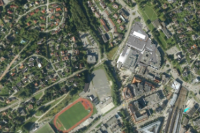

<Item title:"BygningerMedTekstur_Bare_gamle_Trekanten" type:Service Definition owner:giselle.linares_askereu>
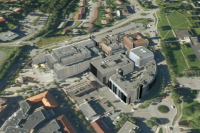

<Item title:"BygningerMedTekstur_NY_utm32_v9" type:Service Definition owner:giselle.linares_askereu>
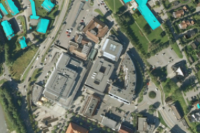

<Item title:"BygningerMedTekstur_NY_utm33_v8" type:Service Definition owner:giselle.linares_askereu>
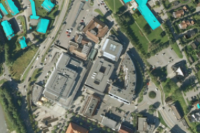

<Item title:"BygningerMedTekstur_uten_gamle_Trekanten" type:Service Definition owner:giselle.linares_askereu>
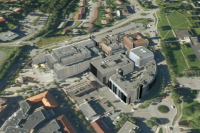

<Item title:"BygningerMedTekstur_uten_trekanten_v2" type:Service Definition owner:giselle.linares_askereu>
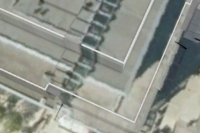

<Item title:"BygningerMedTekstur_uten_trekanten_v3" type:Service Definition owner:giselle.linares_askereu>
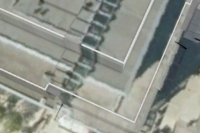

<Item title:"BygningerMedTekstur_uten_trekanten_v4" type:Service Definition owner:giselle.linares_askereu>
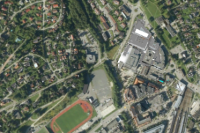

<Item title:"BygningerMedTekstur_uten_trekanten_v5" type:Service Definition owner:giselle.linares_askereu>
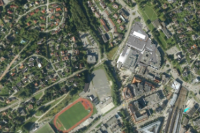

<Item title:"BygningerMedTekstur_uten_trekanten_v6" type:Service Definition owner:giselle.linares_askereu>
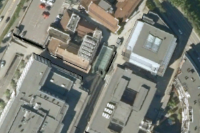

<Item title:"bygningsflater_overvannsanalyse_090621" type:Service Definition owner:giselle.linares_askereu>
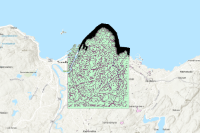

<Item title:"bygningsflater_overvannsanalyse_150621" type:Service Definition owner:giselle.linares_askereu>
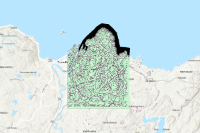

<Item title:"bygningsflater_overvannsanalyse_290621" type:Service Definition owner:giselle.linares_askereu>
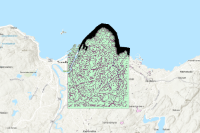

<Item title:"asker2010_PNG" type:Service Definition owner:giselle.linares_askereu>
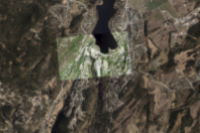

<Item title:"asker2020_PNG" type:Service Definition owner:giselle.linares_askereu>
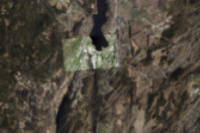

<Item title:"asker2020_PNG_V2" type:Service Definition owner:giselle.linares_askereu>
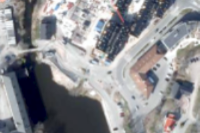

<Item title:"asker2020_PNG_V3" type:Service Definition owner:giselle.linares_askereu>
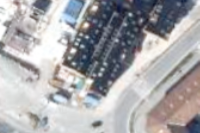

<Item title:"asker_kpi" type:Service Definition owner:giselle.linares_askereu>
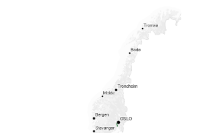

<Item title:"AskerOmegn_selvlagdOmriss_Union" type:Service Definition owner:giselle.linares_askereu>
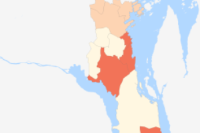

<Item title:"AskerOmegn_selvlagdOmriss_Union_tile" type:Service Definition owner:giselle.linares_askereu>
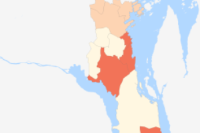

<Item title:"AskerOmegn_selvlagdOmriss_Union_vectortile" type:Service Definition owner:giselle.linares_askereu>
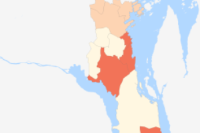

<Item title:"Ble gpx" type:Service Definition owner:giselle.linares_askereu>
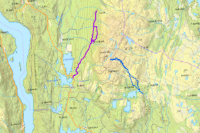

<Item title:"blefjell" type:Service Definition owner:giselle.linares_askereu>
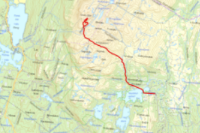

<Item title:"BmNaturtypeOmråde Naturbase" type:Service Definition owner:giselle.linares_askereu>
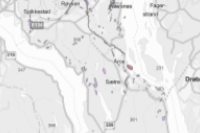

<Item title:"bor_AnnetSted_jobberAsker" type:Service Definition owner:giselle.linares_askereu>
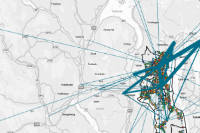

<Item title:"bor_Asker_jobber_AnnetSted" type:Service Definition owner:giselle.linares_askereu>
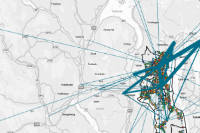

<Item title:"bor_jobber_kommune_Alt" type:Service Definition owner:giselle.linares_askereu>
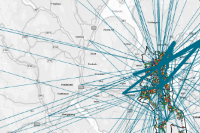

<Item title:"bor_jobber_kommune_over30" type:Service Definition owner:giselle.linares_askereu>
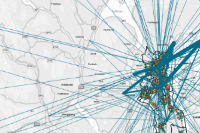

<Item title:"bor_jobber_kommune_v3_XYToLi1" type:Service Definition owner:giselle.linares_askereu>
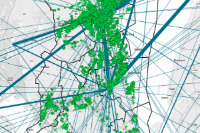

<Item title:"bor_jobber_kommune_v3_XYToLi1_CopyFeatures" type:Service Definition owner:giselle.linares_askereu>
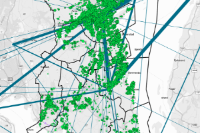

<Item title:"Borpunkter_3_rapporter" type:Service Definition owner:giselle.linares_askereu>
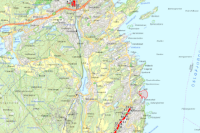

<Item title:"Borpunkter_8" type:Service Definition owner:giselle.linares_askereu>
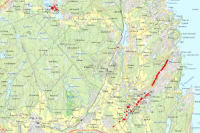

<Item title:"Borpunkter_v2" type:Service Definition owner:giselle.linares_askereu>
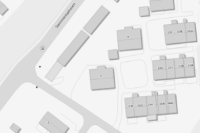

<Item title:"budstikka_smitte_alder_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
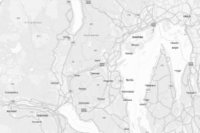

<Item title:"budstikka_smitte_kjonn_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
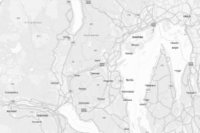

<Item title:"Bygninger3D_Asker_IkkeNaering" type:Service Definition owner:giselle.linares_askereu>
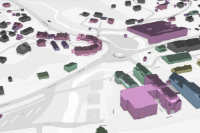

<Item title:"Lokalomraader_26042021" type:Service Definition owner:giselle.linares_askereu>
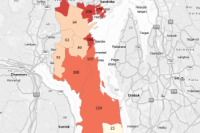

<Item title:"Lokalområde_2" type:Service Definition owner:giselle.linares_askereu>
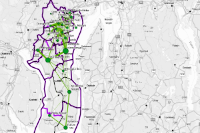

<Item title:"Lokalområder" type:Service Definition owner:giselle.linares_askereu>
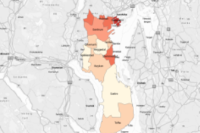

<Item title:"Lokalsenter_punkt" type:Service Definition owner:giselle.linares_askereu>
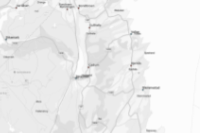

<Item title:"Lokalsenter_punkt_v2" type:Service Definition owner:giselle.linares_askereu>
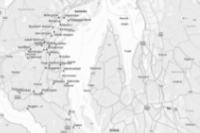

<Item title:"markagrensa_gml_hurum_underarbeid" type:Service Definition owner:giselle.linares_askereu>
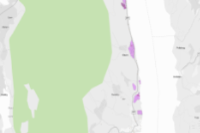

<Item title:"markagrensa_gml_hurum_underarbeid_LINJE" type:Service Definition owner:giselle.linares_askereu>
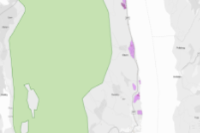

<Item title:"Markagrense" type:Service Definition owner:giselle.linares_askereu>
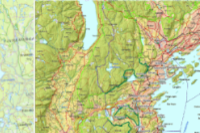

<Item title:"MATRIKKEL_ByggPunkt_join_LYDIA" type:Service Definition owner:giselle.linares_askereu>
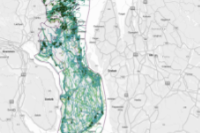

<Item title:"MATRIKKEL_ByggPunkt_join_LYDIA_Driftsenhet" type:Service Definition owner:giselle.linares_askereu>
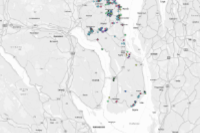

<Item title:"MATRIKKEL_DekTeigeierflate_inter_KPA1300" type:Service Definition owner:giselle.linares_askereu>
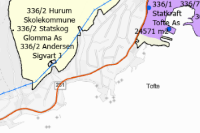

<Item title:"meter400_rundt10til30minFrekvensBusstopp_DISSOLVED_copy" type:Service Definition owner:giselle.linares_askereu>
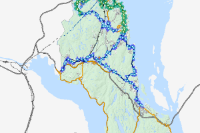

<Item title:"meter500_rundt0til10minFrekventeBusstopp_DISSOLVED_Copy" type:Service Definition owner:giselle.linares_askereu>
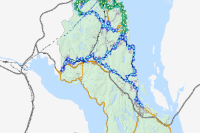

<Item title:"Mike dybde x hastighet" type:Service Definition owner:giselle.linares_askereu>
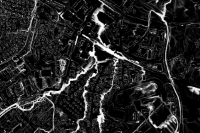

<Item title:"Mike Maksvanndyp x Makshastighet" type:Service Definition owner:giselle.linares_askereu>
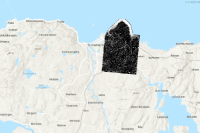

<Item title:"N50_Arealdekke_AskerOmegn_HavOgElv" type:Service Definition owner:giselle.linares_askereu>
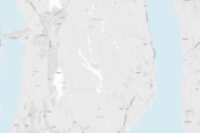

<Item title:"N50_Arealdekke_AskerOmegn_HavOgElv_BLÅ" type:Service Definition owner:giselle.linares_askereu>
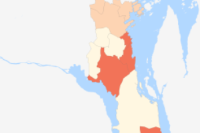

<Item title:"N50_Arealdekke_AskerOmegn_Vann_alt" type:Service Definition owner:giselle.linares_askereu>
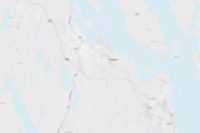

<Item title:"Næring_foretakspunkt_ikkeENKOver0ansatte" type:Service Definition owner:giselle.linares_askereu>
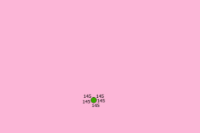

<Item title:"Nærsenter_punkt" type:Service Definition owner:giselle.linares_askereu>
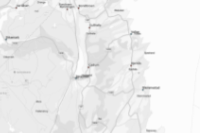

<Item title:"Demografi_ansatte" type:Service Definition owner:giselle.linares_askereu>
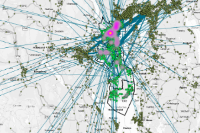

<Item title:"Demografi_Asker_2km_heatmap" type:Service Definition owner:giselle.linares_askereu>
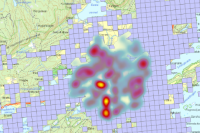

<Item title:"Demografi_Asker_2km_kopi" type:Service Definition owner:giselle.linares_askereu>
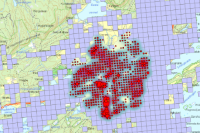

<Item title:"DEMOGRAFI_DemografiGrid200mPunkt_2020_2020_2019_2012_ASKER" type:Service Definition owner:giselle.linares_askereu>
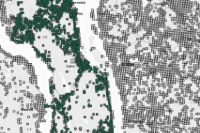

<Item title:"DEMOGRAFI_DemografiGrid200mPunkt_2021_personer" type:Service Definition owner:giselle.linares_askereu>
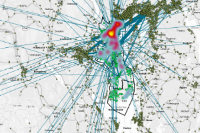

<Item title:"Demografi_grunnkrets" type:Service Definition owner:giselle.linares_askereu>
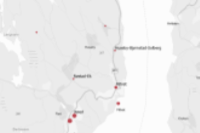

<Item title:"Distribusjonsnett" type:Service Definition owner:giselle.linares_askereu>
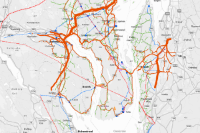

<Item title:"dummytall_1_ExcelToTable_smittede_20_04" type:Service Definition owner:giselle.linares_askereu>
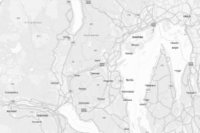

<Item title:"dummytall_testede_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
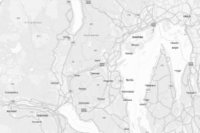

<Item title:"dybde x hastighet invert" type:Service Definition owner:giselle.linares_askereu>
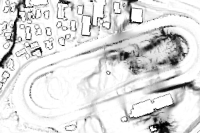

<Item title:"Endringer_arealformål_160322_kjellTore" type:Service Definition owner:giselle.linares_askereu>
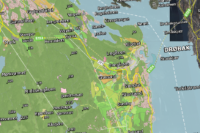

<Item title:"FEATURE_NySymboliseringsfil_EldreRegplan_utm33" type:Service Definition owner:giselle.linares_askereu>
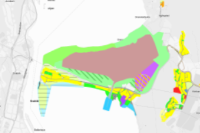

<Item title:"felles_Merge" type:Service Definition owner:giselle.linares_askereu>
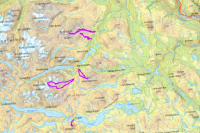

<Item title:"Flomveger_V0" type:Service Definition owner:giselle.linares_askereu>
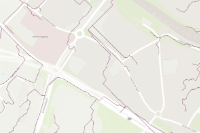

<Item title:"Flomveger_V1" type:Service Definition owner:giselle.linares_askereu>
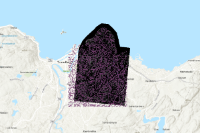

<Item title:"Footprints_ASKER_AlleTreTyper_omrader" type:Service Definition owner:giselle.linares_askereu>
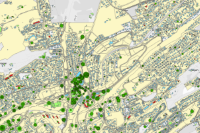

<Item title:"Footprints_ASKER_AlleTreTyper_omrader_v2" type:Service Definition owner:giselle.linares_askereu>
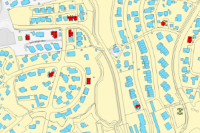

<Item title:"Footprints_ASKER_AlleTreTyper_omrader_v3" type:Service Definition owner:giselle.linares_askereu>
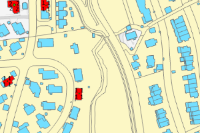

<Item title:"Footprints_ASKER_ikkeNaering" type:Service Definition owner:giselle.linares_askereu>
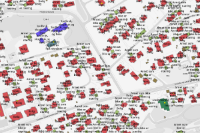

<Item title:"Footprints_ASKER_ikkeNaering_omraader" type:Service Definition owner:giselle.linares_askereu>
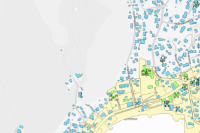

<Item title:"Footprints_ASKER_ikkeNaering_områdenavn" type:Service Definition owner:giselle.linares_askereu>
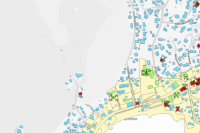

<Item title:"Footprints_ASKER_Naering" type:Service Definition owner:giselle.linares_askereu>
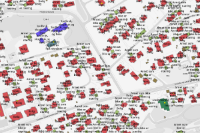

<Item title:"Footprints_ASKER_Naering_feature_ÅS" type:Service Definition owner:giselle.linares_askereu>
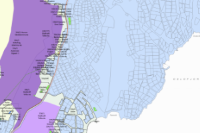

<Item title:"Footprints_ASKER_Naering_omådenavn" type:Service Definition owner:giselle.linares_askereu>
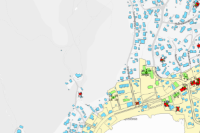

<Item title:"Footprints_ASKER_Naering_tile_ÅS" type:Service Definition owner:giselle.linares_askereu>
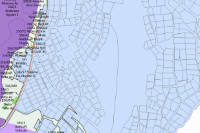

<Item title:"Footprints_ASKER_Naering_vectortile_ÅS" type:Service Definition owner:giselle.linares_askereu>
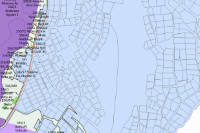

<Item title:"Fra_peakbook" type:Service Definition owner:giselle.linares_askereu>
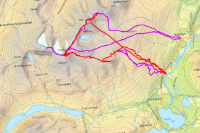

<Item title:"Fritidsbebyggelse matrikkelbyggpunkt" type:Service Definition owner:giselle.linares_askereu>
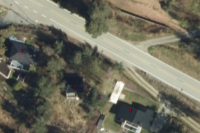

<Item title:"Smittetde_14_dager_aldersfordelt_2204_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
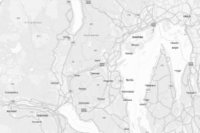

<Item title:"ssn_ispshavneanlegg" type:Service Definition owner:giselle.linares_askereu>
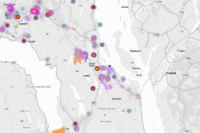

<Item title:"Stemmekrets_2021" type:Service Definition owner:giselle.linares_askereu>
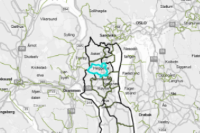

<Item title:"Stemmekrets_2021_Klippet" type:Service Definition owner:giselle.linares_askereu>
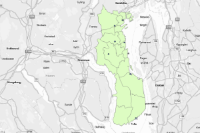

<Item title:"Stemmelokale_forhåndsstemmer" type:Service Definition owner:giselle.linares_askereu>
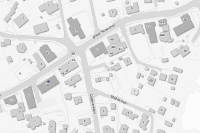

<Item title:"Stikkrenner_bekk_i_rør_LL" type:Service Definition owner:giselle.linares_askereu>
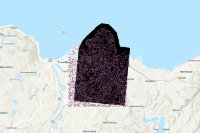

<Item title:"storhaug_3PNG_png" type:Service Definition owner:giselle.linares_askereu>
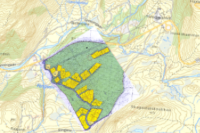

<Item title:"strandlinje" type:Service Definition owner:giselle.linares_askereu>
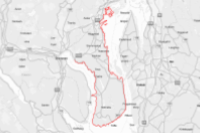

<Item title:"Teig Eier" type:Service Definition owner:giselle.linares_askereu>
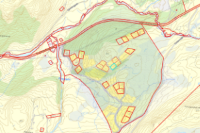

<Item title:"test_multilayer" type:Service Definition owner:giselle.linares_askereu>
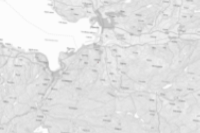

<Item title:"test_multilayer_tile" type:Service Definition owner:giselle.linares_askereu>
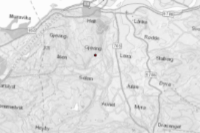

<Item title:"testede_2204_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
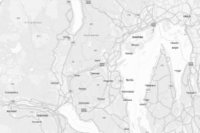

<Item title:"testede_2204_siste24dager_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
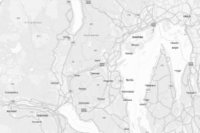

<Item title:"testede_2804_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
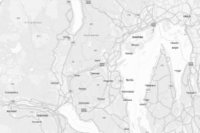

<Item title:"testede_v2_JSONExcelToTable" type:Service Definition owner:giselle.linares_askereu>
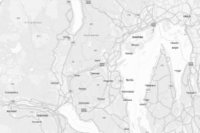

<Item title:"testhus_ExtrudeByAttribute_volumes" type:Service Definition owner:giselle.linares_askereu>
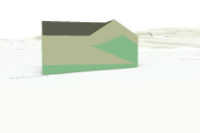

<Item title:"Testtall_enkeltsummer_2204_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
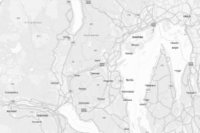

<Item title:"TILE_NySymboliseringsfil_EldreRegplan_utm33" type:Service Definition owner:giselle.linares_askereu>
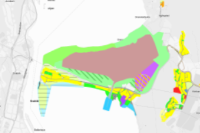

<Item title:"TILE_STOR_FIL_NySymboliseringsfil_nyereRegplan_utm33" type:Service Definition owner:giselle.linares_askereu>
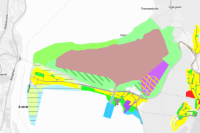

<Item title:"TIN_TinTriangle" type:Service Definition owner:giselle.linares_askereu>
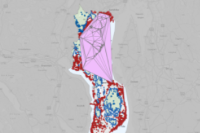

<Item title:"Tr_sk" type:Service Definition owner:giselle.linares_askereu>
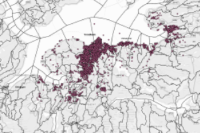

<Item title:"Tr_sk_yp" type:Service Definition owner:giselle.linares_askereu>
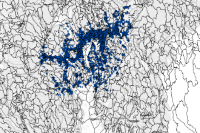

<Item title:"Transformatorstasjon" type:Service Definition owner:giselle.linares_askereu>
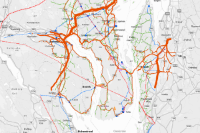

<Item title:"Trekanten geodata IfcWall" type:Service Definition owner:giselle.linares_askereu>
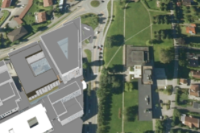

<Item title:"Trekanten120521 IfcWindow" type:Service Definition owner:giselle.linares_askereu>
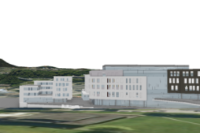

<Item title:"Trekanten120521_IfcWallStandardCase" type:Service Definition owner:giselle.linares_askereu>
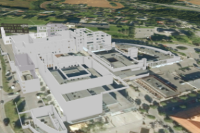

<Item title:"Trekanten_FME_IFC_MULTIPATCH_v3_utm32To33" type:Service Definition owner:giselle.linares_askereu>
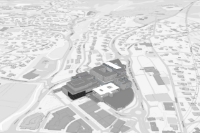

<Item title:"Trekanten_geodata_IfcWallStandardCase" type:Service Definition owner:giselle.linares_askereu>
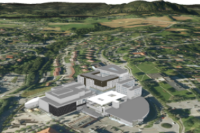

<Item title:"Trekroner_hogges_343" type:Service Definition owner:giselle.linares_askereu>
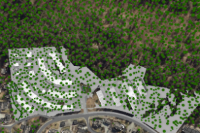

<Item title:"Trekroner_hogst" type:Service Definition owner:giselle.linares_askereu>
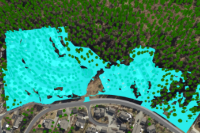

<Item title:"Trekroner_hogstfelt" type:Service Definition owner:giselle.linares_askereu>
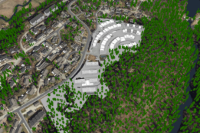

<Item title:"Ukesrapportering_korona_HavElv" type:Service Definition owner:giselle.linares_askereu>
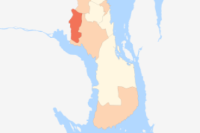

<Item title:"Ukesrapportering_Korona_lokalomraader" type:Service Definition owner:giselle.linares_askereu>
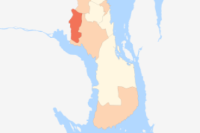

<Item title:"Ukesrapportering_Kovid_Omriss" type:Service Definition owner:giselle.linares_askereu>
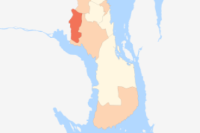

<Item title:"IfcSlabTrekanten120521" type:Service Definition owner:giselle.linares_askereu>
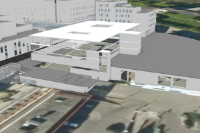

<Item title:"IfcStair Trekanten120521" type:Service Definition owner:giselle.linares_askereu>
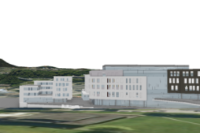

<Item title:"IfcStairFlight ARK_kirkeveien_HOVEDMODELL" type:Service Definition owner:giselle.linares_askereu>
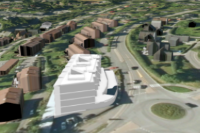

<Item title:"IfcWall ARK_kirkeveien_HOVEDMODELL" type:Service Definition owner:giselle.linares_askereu>
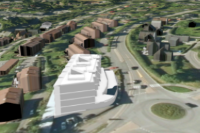

<Item title:"IfcWall Trekanten120521 v2" type:Service Definition owner:giselle.linares_askereu>
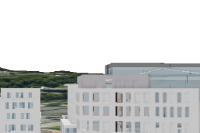

<Item title:"IfcWallStandardCase ARK_kirkeveien_HOVEDMODELL" type:Service Definition owner:giselle.linares_askereu>
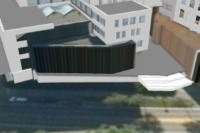

<Item title:"IfcWallStandardCase_utm33" type:Service Definition owner:giselle.linares_askereu>
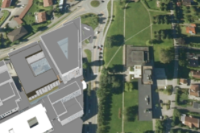

<Item title:"Innbyggertall_asker_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
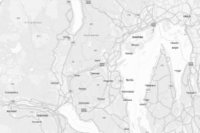

<Item title:"Jthmgpx" type:Service Definition owner:giselle.linares_askereu>
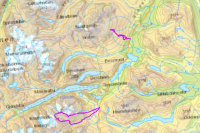

<Item title:"KartlagtFriluftslivsområde_naturbase" type:Service Definition owner:giselle.linares_askereu>
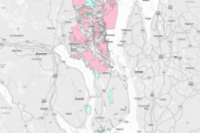

<Item title:"Kirkeveien_multV3_utm32TOutm33" type:Service Definition owner:giselle.linares_askereu>
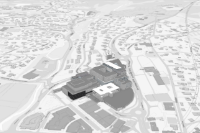

<Item title:"KKollektivakse_medFrekvens_copy" type:Service Definition owner:giselle.linares_askereu>
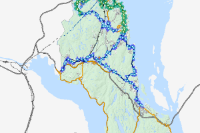

<Item title:"Kollektivakse_busstopp_0til10minFrekvens_copy" type:Service Definition owner:giselle.linares_askereu>
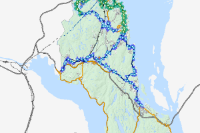

<Item title:"Kollektivakse_busstopp_10til30minFrekvens_copy" type:Service Definition owner:giselle.linares_askereu>
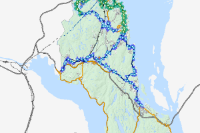

<Item title:"Kollektivaske_medFrekvens" type:Service Definition owner:giselle.linares_askereu>
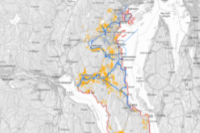

<Item title:"Kollektivaske_medFrekvens_v2" type:Service Definition owner:giselle.linares_askereu>
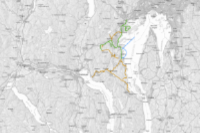

<Item title:"Kommunepunkt_2019" type:Service Definition owner:giselle.linares_askereu>
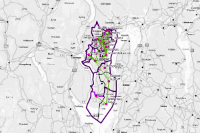

<Item title:"Kommunepunkt_2019_Asker" type:Service Definition owner:giselle.linares_askereu>
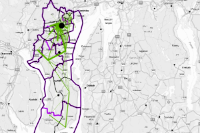

<Item title:"kommuner_ExportFeatures" type:Service Definition owner:giselle.linares_askereu>
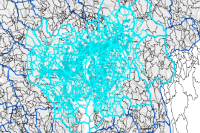

<Item title:"Kommuner_gammel_2019" type:Service Definition owner:giselle.linares_askereu>
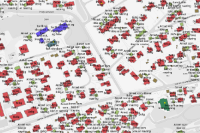

<Item title:"kommuner_kpi" type:Service Definition owner:giselle.linares_askereu>
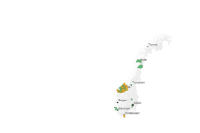

<Item title:"Kommunesenter_punkt" type:Service Definition owner:giselle.linares_askereu>
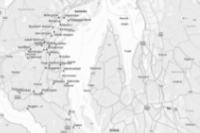

<Item title:"NARING_ForetakPunkt_Asker_ALLE" type:Service Definition owner:giselle.linares_askereu>
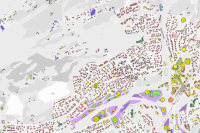

<Item title:"NARING_ForetakPunkt_Asker_Ansatte_ENK" type:Service Definition owner:giselle.linares_askereu>
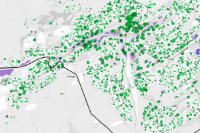

<Item title:"NARING_ForetakPunkt_Asker_Ansatte_IkkeENK" type:Service Definition owner:giselle.linares_askereu>
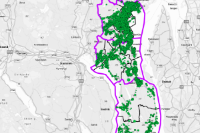

<Item title:"Naturtyper_NiN Naturbase" type:Service Definition owner:giselle.linares_askereu>
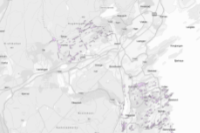

<Item title:"Naturvernområde NATURBASE" type:Service Definition owner:giselle.linares_askereu>
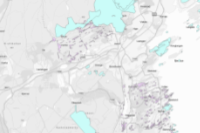

<Item title:"nau2" type:Service Definition owner:giselle.linares_askereu>
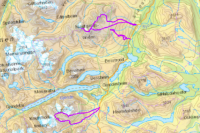

<Item title:"Nedbørfelt_V0" type:Service Definition owner:giselle.linares_askereu>
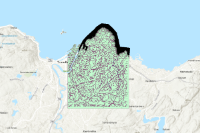

<Item title:"Nedbørfelt_V1" type:Service Definition owner:giselle.linares_askereu>
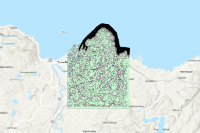

<Item title:"NySymboliseringsfil_nyereRegplan_utm33_feature" type:Service Definition owner:giselle.linares_askereu>
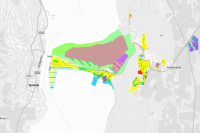

<Item title:"NySymboliseringsfil_nyereRegplan_utm33_tile" type:Service Definition owner:giselle.linares_askereu>
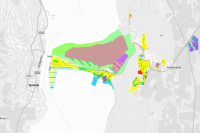

<Item title:"NySymboliseringsfil_nyereRegplan_utm33_vectortile" type:Service Definition owner:giselle.linares_askereu>
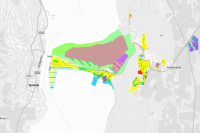

<Item title:"Olav_Brunborg_vei_tree_point_utm33" type:Service Definition owner:giselle.linares_askereu>
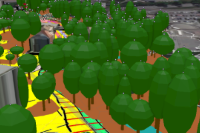

<Item title:"Olav_Brunborgs_vei_Bygninger" type:Service Definition owner:giselle.linares_askereu>
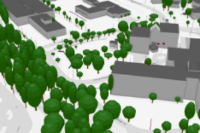

<Item title:"Olav_Brunborgs_vei_Bygninger_UTM33" type:Service Definition owner:giselle.linares_askereu>
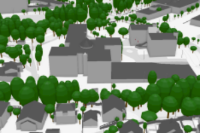

<Item title:"Olav_Brunborgs_vei_Trekrone" type:Service Definition owner:giselle.linares_askereu>
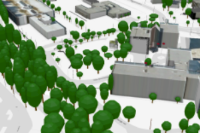

<Item title:"Olav_Brunborgs_vei_Trekrone_UTM33" type:Service Definition owner:giselle.linares_askereu>
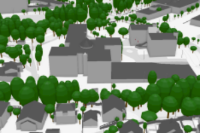

<Item title:"Olav_Brunborgs_vei_Trestamme" type:Service Definition owner:giselle.linares_askereu>
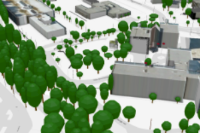

<Item title:"Olav_Brunborgs_vei_Trestamme_UTM33" type:Service Definition owner:giselle.linares_askereu>
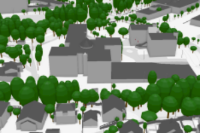

<Item title:"Oppdatert_dato_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
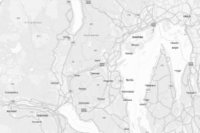

<Item title:"Oppstuvning_V0" type:Service Definition owner:giselle.linares_askereu>
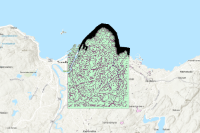

<Item title:"Oppstuvning_V1" type:Service Definition owner:giselle.linares_askereu>
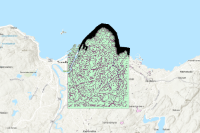

<Item title:"Osm_Roads_Hele_Asker_RIKTIG_0611" type:Service Definition owner:giselle.linares_askereu>
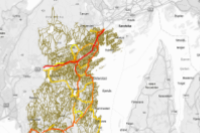

<Item title:"Osm_Roads_Hele_Asker_RIKTIG_0611_tile" type:Service Definition owner:giselle.linares_askereu>
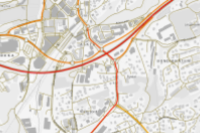

<Item title:"påskrift" type:Service Definition owner:giselle.linares_askereu>
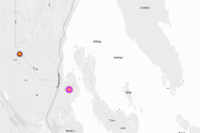

<Item title:"Påskrift_punkter" type:Service Definition owner:giselle.linares_askereu>
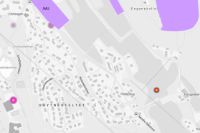

<Item title:"påskrift_v2" type:Service Definition owner:giselle.linares_askereu>
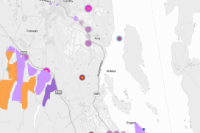

<Item title:"pendlerlinjer_bor_AnnetSted_jobberAsker_v2" type:Service Definition owner:giselle.linares_askereu>
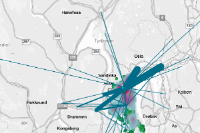

<Item title:"pendlerlinjer_bor_Asker_jobber_AnnetSted_v2" type:Service Definition owner:giselle.linares_askereu>
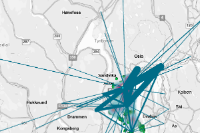

<Item title:"Pendlerlinjer_delomr_alt" type:Service Definition owner:giselle.linares_askereu>
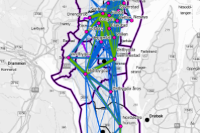

<Item title:"Pendlerlinjer_delomr_over20" type:Service Definition owner:giselle.linares_askereu>
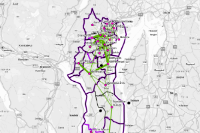

<Item title:"Pendlerlinjer_delomr_over20_v2" type:Service Definition owner:giselle.linares_askereu>
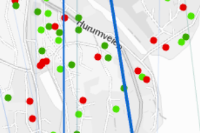

<Item title:"Plansoner_kopi" type:Service Definition owner:giselle.linares_askereu>
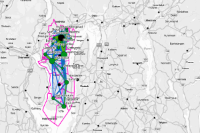

<Item title:"vaksine_2204_Ferdig_fordelte_tall_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
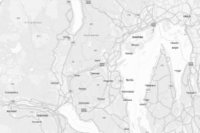

<Item title:"vaksine_2204_Ferdig_fordelte_tall_riktig_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
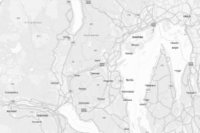

<Item title:"vaksine_2204_redigert_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
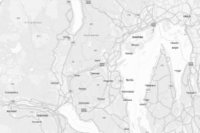

<Item title:"vaksine_v5_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
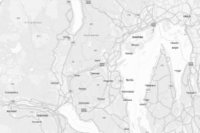

<Item title:"vaksineres_enkelttall_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
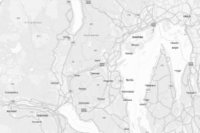

<Item title:"vaksinetall_prosenter_ExcelToTable" type:Service Definition owner:giselle.linares_askereu>
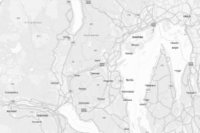

<Item title:"Vann_flate_grunnkart" type:Service Definition owner:giselle.linares_askereu>
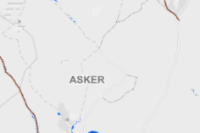

<Item title:"Vann_flate_minus_hav_kilde_grunnkart" type:Service Definition owner:giselle.linares_askereu>
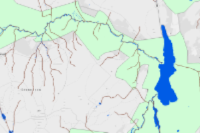

<Item title:"VECTORTILE_NySymboliseringsfil_EldreRegplan_utm33" type:Service Definition owner:giselle.linares_askereu>
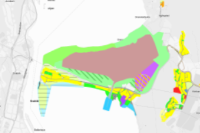

<Item title:"Vegkategori_europa_fylkesvei" type:Service Definition owner:giselle.linares_askereu>
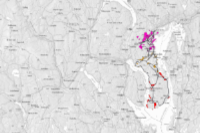

<Item title:"Vegnett_ÅDT" type:Service Definition owner:giselle.linares_askereu>
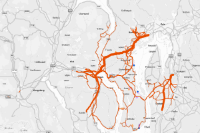

<Item title:"Vekstomraade" type:Service Definition owner:giselle.linares_askereu>
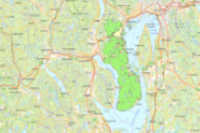

<Item title:"Vekstomraade2" type:Service Definition owner:giselle.linares_askereu>
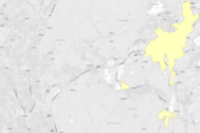

<Item title:"Vi_sk" type:Service Definition owner:giselle.linares_askereu>
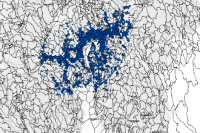

<Item title:"Vi_sk_060816" type:Service Definition owner:giselle.linares_askereu>
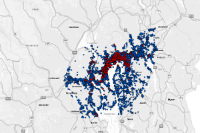

<Item title:"WFS_innbyggerdialog_komplanrevisjon_full_kopi_21102020" type:Service Definition owner:giselle.linares_askereu>
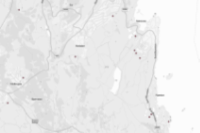

<Item title:"WFS_innbyggerdialog_strippet" type:Service Definition owner:giselle.linares_askereu>
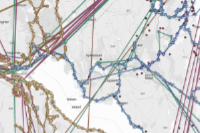

<Item title:"Gpx_Haakon_ble" type:Service Definition owner:giselle.linares_askereu>
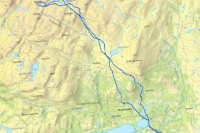

<Item title:"Hytter og annen fritidsbygg" type:Service Definition owner:giselle.linares_askereu>
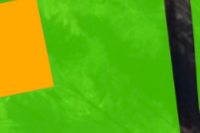

<Item title:"Hytter_i_strandsone100metersbelte" type:Service Definition owner:giselle.linares_askereu>
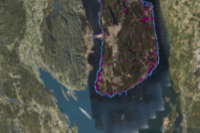

<Item title:"IfcBeam Trekanten120521" type:Service Definition owner:giselle.linares_askereu>
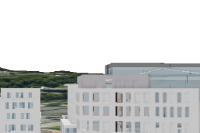

<Item title:"IfcBuildingElementProxy Trekanten120521" type:Service Definition owner:giselle.linares_askereu>
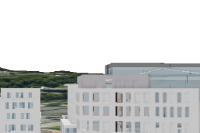

<Item title:"IfcColumn Trekanten120521" type:Service Definition owner:giselle.linares_askereu>
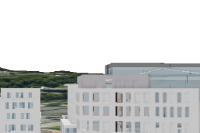

<Item title:"IfcCurtainWall Trekanten120521" type:Service Definition owner:giselle.linares_askereu>
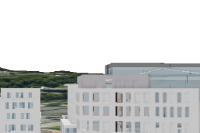

<Item title:"IfcDoor Trekanten120521" type:Service Definition owner:giselle.linares_askereu>
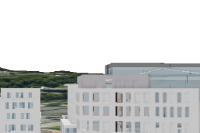

<Item title:"IfcFurnishingElement_surface_3D" type:Service Definition owner:giselle.linares_askereu>
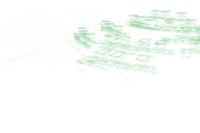

<Item title:"IfcMember Trekanten120521" type:Service Definition owner:giselle.linares_askereu>
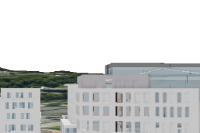

<Item title:"IfcRailing ARK_kirkeveien_HOVEDMODELL" type:Service Definition owner:giselle.linares_askereu>
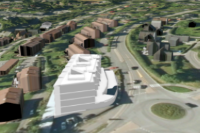

<Item title:"IfcRamp ARK_kirkeveien_HOVEDMODELL" type:Service Definition owner:giselle.linares_askereu>
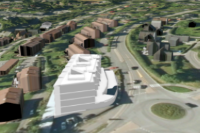

<Item title:"IfcRampFlight ARK_kirkeveien_HOVEDMODELL" type:Service Definition owner:giselle.linares_askereu>
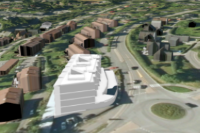

<Item title:"IfcSlab ARK_kirkeveien_HOVEDMODELL" type:Service Definition owner:giselle.linares_askereu>
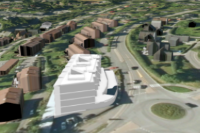

<Item title:"IfcSlab_surface" type:Service Definition owner:giselle.linares_askereu>
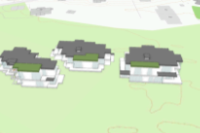

In [332]:
#Clon Service Definition and share privacy
target_index= content_df[combined_mask].index
for i in target_index:
    source_data = content_df.loc[i].id
    #print(target_data)
    source_content = source.content.get(source_data)
    
    #find item's owner
    source_item_owner = source.users.search(source_content.owner)[0]
    #find item's folder
    item_folder_titles = [f['title'] for f in source_item_owner.folders 
                          if f['id'] == source_content.ownerFolder]
    folder_name = None
    if len(item_folder_titles) > 0:
        folder_name = item_folder_titles[0]

    #if folder does not exist for target user, create it
    if folder_name:
        target_user = target.users.search(source_content.owner)[0]
        target_user_folders = [f['title'] for f in target_user.folders
                               if f['title'] == folder_name]
        if len(target_user_folders) == 0:
    #create the folder
            target.content.create_folder(folder_name, target_user.username)
    cloned_items = target.content.clone_items([source_content], copy_data=True, search_existing_items=True, folder=folder_name) 
    for ci in cloned_items:
        display(ci)
    if source_content.access == "org":
        ci.share(everyone=False, org=True, groups=target_group.id)
    else:
        ci.share(everyone=True, org=False, groups=target_group.id)


### Reassign layer to owner

In [375]:
#Reassign feature layers to owner
for i in range(len(diff_list)):
    diff=df2_fs[df2_fs['title']==diff_list[i]]
    target_index= diff.index
    print(target_index)
    for i in target_index:
        fs_data = tar_content_df.loc[i].id
        #print(fs_data)
        fs_content = target.content.get(fs_data)
        fs_content.reassign_to('Asmund.Stemme@asker.kommune.no_askereu')

Int64Index([878], dtype='int64')
Int64Index([769], dtype='int64')
Int64Index([770], dtype='int64')
Int64Index([827], dtype='int64')
Int64Index([821], dtype='int64')
Int64Index([824], dtype='int64')
Int64Index([847], dtype='int64')
Int64Index([883], dtype='int64')
Int64Index([857], dtype='int64')
Int64Index([766], dtype='int64')
Int64Index([776], dtype='int64')
Int64Index([873], dtype='int64')
Int64Index([744], dtype='int64')
Int64Index([814], dtype='int64')
Int64Index([839], dtype='int64')
Int64Index([881], dtype='int64')
Int64Index([746], dtype='int64')
Int64Index([796], dtype='int64')
Int64Index([825], dtype='int64')
Int64Index([767], dtype='int64')
Int64Index([874], dtype='int64')
Int64Index([768], dtype='int64')
Int64Index([813], dtype='int64')
Int64Index([799], dtype='int64')
Int64Index([879], dtype='int64')
Int64Index([788], dtype='int64')
Int64Index([890], dtype='int64')
Int64Index([822], dtype='int64')
Int64Index([834], dtype='int64')
Int64Index([801], dtype='int64')
Int64Index

### Make an item map for cloning of existing items in the target dataframe

In [ ]:
source_target_itemId_map = {}
for key_source,value_source in source_items_by_id.items():
    for key_target, value_target in target_items_by_id.items():
        if (target_items_by_id.get(key_target).title == source_items_by_id.get(key_source).title) and (target_items_by_id.get(key_target).type == source_items_by_id.get(key_source).type):
            #print(target_items_by_id.get(key_target).title)
            source_target_itemId_map_test[key_source] = key_target
print(source_target_itemId_map_test)